<a href="https://colab.research.google.com/github/yelmokht/nuclei-segmentation/blob/main/nuclei.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

> # 0. Constants, parameters and paths

In [1]:
ROOT_PATH = '/content/'
DRIVE_PATH = ROOT_PATH + "drive/MyDrive/Colab Notebooks/"
SOURCE_PATH = DRIVE_PATH + 'data-science-bowl-2018.zip'
UNZIPPED_PATH = ROOT_PATH + 'unzipped/'
DESTINATION_PATH = DATA_PATH = ROOT_PATH + 'dsb_2018/'
TRAIN_PATH = DATA_PATH + 'stage1_train/'
TEST_1_PATH = DATA_PATH + 'stage1_test/'
TEST_2_PATH = DATA_PATH + 'stage2_test/'
STAGE_1_PATH = DATA_PATH + 'stage1_test/'
STAGE_2_PATH = DATA_PATH + 'stage2_test/'
STAGE_1_SOLUTION_PATH = DATA_PATH + 'stage1_solution/stage1_solution.csv'
STAGE_2_SOLUTION_PATH = DATA_PATH + 'stage2_solution/stage2_solution.csv'
IMAGE_HEIGHT = MASK_HEIGHT = 256
IMAGE_WIDTH = MASK_WIDTH = 256
IMAGE_NUM_CHANNELS = 3
MASK_NUM_CHANNELS = 1
IMAGE_SHAPE = (IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_NUM_CHANNELS)
MASK_SHAPE = (MASK_HEIGHT, MASK_WIDTH, MASK_NUM_CHANNELS)
INPUT_SHAPE = IMAGE_SHAPE
SEED = 42
BATCH_SIZE = 32
EPOCHS = 100
SAVE_MODEL_PATH = DRIVE_PATH + f'model_{EPOCHS}.keras'
SAVE_HISTORY_PATH = DRIVE_PATH + f'model_{EPOCHS}_history.csv'
LOAD_MODEL_PATH = DRIVE_PATH + f'model_{EPOCHS}.keras'
LOAD_HISTORY_PATH = DRIVE_PATH + f'model_{EPOCHS}_history.csv'
BEST_MODEL_PATH = DRIVE_PATH + 'best_model.keras'
BEST_HISTORY_PATH = DRIVE_PATH + 'best_history.csv'
SUBMISSION_PATH = DRIVE_PATH + 'submission.csv'
SOLUTION_PATH = DRIVE_PATH + 'solution.csv'

> # 1. Unzip the dataset and structure the data

In [2]:
import os
import shutil
from zipfile import ZipFile

def unzip_and_structure_data(source_path, unzipped_path, destination_path):
    # Unzip files from source to unzipped
    if not os.path.exists(unzipped_path):
        with ZipFile(source_path, 'r') as zip_ref:
            zip_ref.extractall(unzipped_path)
        print("Files unzipped successfully.")
    else:
        print("Unzipped files already exist.")

    # Structure data from unzipped to destination
    if not os.path.exists(destination_path):
        for root, dirs, files in os.walk(unzipped_path):
            for filename in files:
                if filename.endswith(".zip"):
                    zip_file_path = os.path.join(root, filename)
                    output_folder = os.path.join(destination_path, os.path.splitext(filename)[0])
                    with ZipFile(zip_file_path, 'r') as zip_ref:
                        zip_ref.extractall(output_folder)
                    print(f"Unzipped {filename} to {output_folder}")
        print("Data files structured successfully.")
    else:
        print("Data files already exist.")

In [3]:
unzip_and_structure_data(SOURCE_PATH, UNZIPPED_PATH, DESTINATION_PATH)

Files unzipped successfully.
Unzipped stage1_sample_submission.zip to /content/dsb_2018/stage1_sample_submission
Unzipped stage1_train.zip to /content/dsb_2018/stage1_train
Unzipped stage1_train_labels.zip to /content/dsb_2018/stage1_train_labels
Unzipped stage2_solution.zip to /content/dsb_2018/stage2_solution
Unzipped stage2_sample_submission.zip to /content/dsb_2018/stage2_sample_submission
Unzipped stage1_solution.zip to /content/dsb_2018/stage1_solution
Unzipped stage2_test.zip to /content/dsb_2018/stage2_test
Unzipped stage1_test.zip to /content/dsb_2018/stage1_test
Data files structured successfully.


> # 2. Decode RLE masks for each stage and save them

In [4]:
import numpy as np
import pandas as pd
import os
from skimage.io import imsave
from tqdm.auto import tqdm
import warnings

warnings.filterwarnings('ignore', category=UserWarning)

def rle_decode(rle_list, mask_shape, mask_dtype):
    masks = []
    for j, rle in enumerate(rle_list):
        mask = np.zeros(np.prod(mask_shape), dtype=mask_dtype)
        s = rle.split()
        starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
        starts -= 1
        ends = starts + lengths
        for lo, hi in zip(starts, ends):
            mask[lo:hi] = 255
        masks.append(mask.reshape(mask_shape[::-1]).T)
    return np.array(masks)

def rle_to_masks(csv_path):
    gt_masks = {}
    df = pd.read_csv(csv_path, sep=',')
    image_ids = sorted(list(df['ImageId'].unique()))

    for image_id in image_ids:
        mask_rles = df.loc[df['ImageId'] == image_id]
        rle_list = mask_rles['EncodedPixels']
        heigth, width = pd.unique(mask_rles['Height'])[0], pd.unique(mask_rles['Width'])[0]
        masks = rle_decode(rle_list=rle_list, mask_shape=(heigth, width), mask_dtype=np.uint16)
        gt_masks[image_id] = masks

    return gt_masks

def save_masks(source_path, destination_path, stage):
    # Load masks
    gt_masks = rle_to_masks(source_path)

    # Iterate over each key in gt_masks
    for folder_id, masks in tqdm(gt_masks.items(), desc=f'{stage} images'):
        folder_path = os.path.join(destination_path, str(folder_id))
        if not os.path.exists(folder_path):
            raise FileNotFoundError(f"Destination folder '{folder_path}' does not exist.")

        # Create masks folder inside the folder
        masks_folder_path = os.path.join(folder_path, 'masks')
        if not os.path.exists(masks_folder_path):
            os.makedirs(masks_folder_path)  # Create masks folder if it doesn't exist
            # Iterate over each value in gt_masks[key] (list of masks)
            for idx, mask in enumerate(masks):
                # Save mask as an image file in the masks folder
                mask_filename = f'{folder_id}_{idx}.png'
                mask_file_path = os.path.join(masks_folder_path, mask_filename)
                imsave(mask_file_path, mask)

    print(f'{stage} masks successfully saved !')

def remove_ignored_images_masks(csv_path, destination_path):
    df = pd.read_csv(csv_path)
    ignore_images = df.loc[df['Usage'] == 'Ignored', 'ImageId'].tolist()

    for image_id in ignore_images:
        folder_path = os.path.join(destination_path, image_id)
        if os.path.exists(folder_path):
            shutil.rmtree(folder_path)
        else:
            print(f"Folder '{folder_path}' doesn't exist.")
        df = df[df['ImageId'] != image_id]

    df.to_csv(csv_path, index=False)
    print('stage2_solution.csv updated !')
    print('Images and masks of stage 2 updated !')

In [5]:
save_masks(STAGE_1_SOLUTION_PATH, STAGE_1_PATH, 'Stage 1')
save_masks(STAGE_2_SOLUTION_PATH, STAGE_2_PATH, 'Stage 2')
remove_ignored_images_masks(STAGE_2_SOLUTION_PATH, TEST_2_PATH)

Stage 1 images:   0%|          | 0/65 [00:00<?, ?it/s]

Stage 1 masks successfully saved !


Stage 2 images:   0%|          | 0/3019 [00:00<?, ?it/s]

Stage 2 masks successfully saved !
stage2_solution.csv updated !
Images and masks of stage 2 updated !


> # 3. Load the data

In [6]:
from skimage.io import imread
from glob import glob
from tqdm.auto import tqdm
import numpy as np
from skimage.measure import regionprops, label
from skimage.transform import resize

def read_image(image_path):
    return imread(image_path).astype(np.uint8)

def binary_mask(id):
    masks_paths = glob(id + '/masks/*.png')
    masks = np.array([read_image(mask_path) for mask_path in masks_paths])
    num_masks, height, width = masks.shape
    binary_mask = np.zeros((height, width), np.uint8)
    for index in range(0, num_masks):
        binary_mask[masks[index] > 0] = 255
    return binary_mask

def load_data(train_path, test_1_path, test_2_path):
    train_image_paths = sorted(glob(train_path + '*/images/*.png'))
    test_1_image_paths = sorted(glob(test_1_path + '*/images/*.png'))
    test_2_image_paths = sorted(glob(test_2_path + '*/images/*.png'))

    train_ids = [path.rsplit('/', 2)[0] for path in train_image_paths]
    test_1_ids = [path.rsplit('/', 2)[0] for path in test_1_image_paths]
    test_2_ids = [path.rsplit('/', 2)[0] for path in test_2_image_paths]

    train_images = [read_image(image_path) for image_path in tqdm(train_image_paths, desc='Train images')]
    test_1_images = [read_image(image_path) for image_path in tqdm(test_1_image_paths, desc='Test images (stage 1)')]
    test_2_images = [read_image(image_path) for image_path in tqdm(test_2_image_paths, desc='Test images (stage 2)')]

    train_masks = [binary_mask(id) for id in tqdm(train_ids, desc='Train masks')]
    test_1_masks = [binary_mask(id) for id in tqdm(test_1_ids, desc='Test masks (stage 1)')]
    test_2_masks = [binary_mask(id) for id in tqdm(test_2_ids, desc='Test masks (stage 2)')]

    train_images += test_1_images
    train_masks += test_1_masks

    return train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks

In [7]:
train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks = load_data(TRAIN_PATH, TEST_1_PATH, TEST_2_PATH)

Train images:   0%|          | 0/670 [00:00<?, ?it/s]

Test images (stage 1):   0%|          | 0/65 [00:00<?, ?it/s]

Test images (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

Train masks:   0%|          | 0/670 [00:00<?, ?it/s]

Test masks (stage 1):   0%|          | 0/65 [00:00<?, ?it/s]

Test masks (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

> # 4. Visualize the data

In [55]:
import matplotlib.pyplot as plt
from ipywidgets import interact, IntSlider, Layout

def plot_images(train_images, train_masks, test_1_images, test_1_masks, test_2_images, test_2_masks):
    @interact(index_0=IntSlider(min=0, max=len(train_images)-1, continuous_update=False, description='Train index'),
              index_1=IntSlider(min=0, max=len(test_1_images)-1, continuous_update=False, description='Test 1 index'),
              index_2=IntSlider(min=0, max=len(test_2_images)-1, continuous_update=False, description='Test 2 index'))
    def update_plot(index_0, index_1, index_2):
        fig, axes = plt.subplots(2, 3, figsize=(18, 8), layout='compressed')

        axes[0, 0].imshow(train_images[index_0])
        axes[0, 0].set_title(f'Train image n°{index_0}')
        axes[1, 0].imshow(train_masks[index_0])
        axes[1, 0].set_title(f'Train mask n°{index_0}')

        axes[0, 1].imshow(test_1_images[index_1])
        axes[0, 1].set_title(f'Test 1 image n°{index_1}')
        axes[1, 1].imshow(test_1_masks[index_1])
        axes[1, 1].set_title(f'Test 1 mask n°{index_1}')

        axes[0, 2].imshow(test_2_images[index_2])
        axes[0, 2].set_title(f'Test 2 image n°{index_2}')
        axes[1, 2].imshow(test_2_masks[index_2])
        axes[1, 2].set_title(f'Test 2 mask n°{index_2}')

        plt.show()

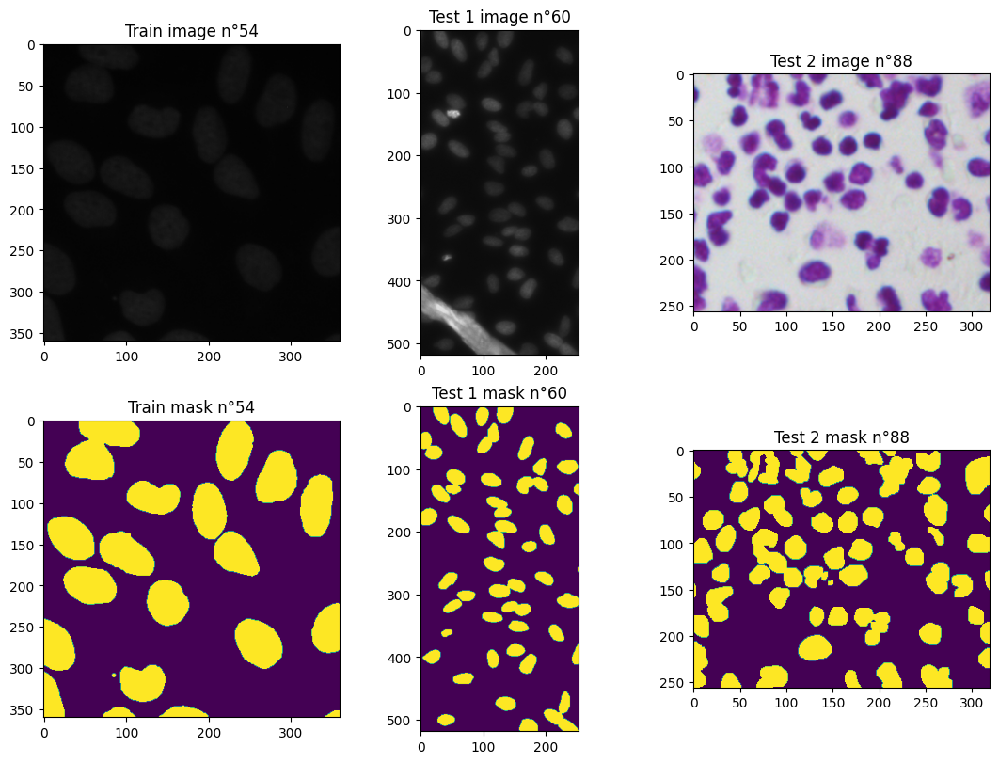

In [37]:
plot_images(train_images, train_masks, test_1_images, test_1_masks, test_2_images, test_2_masks)

> # 5. Analyze the data

In [10]:
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

def analyze_data(train_images, test_1_images, test_2_images):
    train_sizes = [(image.shape[0], image.shape[1]) for image in train_images]
    test_1_sizes = [(image.shape[0], image.shape[1]) for image in test_1_images]
    test_2_sizes = [(image.shape[0], image.shape[1]) for image in test_2_images]

    all_sizes = train_sizes + test_1_sizes + test_2_sizes
    unique_sizes, counts = np.unique(all_sizes, return_counts=True, axis=0)
    unique_sizes = [tuple(size) for size in unique_sizes]

    fig, ax = plt.subplots(figsize=(10, 6))

    for label, sizes in zip(['Train', 'Test 1', 'Test 2'], [train_sizes, test_1_sizes, test_2_sizes]):
        sizes_flat = np.array(sizes)
        sizes_tuples = [tuple(size) for size in sizes_flat]
        counts = Counter(sizes_tuples)
        ax.bar(range(len(unique_sizes)), [counts[size_tuple] for size_tuple in unique_sizes], alpha=0.5, label=label)

    ax.set_title('Image Sizes Distribution')
    ax.set_xlabel('Image size (height x width)')
    ax.set_ylabel('Count')
    ax.set_xticks(range(len(unique_sizes)))
    ax.set_xticklabels([f"{size[0]}x{size[1]}" for size in unique_sizes], rotation=45)
    ax.legend()

    plt.tight_layout()
    plt.show()

    most_common_overall = Counter(tuple(map(tuple, all_sizes))).most_common(1)[0][0]

    most_common = {
        "Train set": Counter(tuple(map(tuple, train_sizes))).most_common(1)[0][0],
        "Test 1 set": Counter(tuple(map(tuple, test_1_sizes))).most_common(1)[0][0],
        "Test 2 set": Counter(tuple(map(tuple, test_2_sizes))).most_common(1)[0][0],
        "Overall": most_common_overall
    }

    for set_name, size in most_common.items():
        print(f"Most common size in {set_name}:", size)

    return most_common_overall


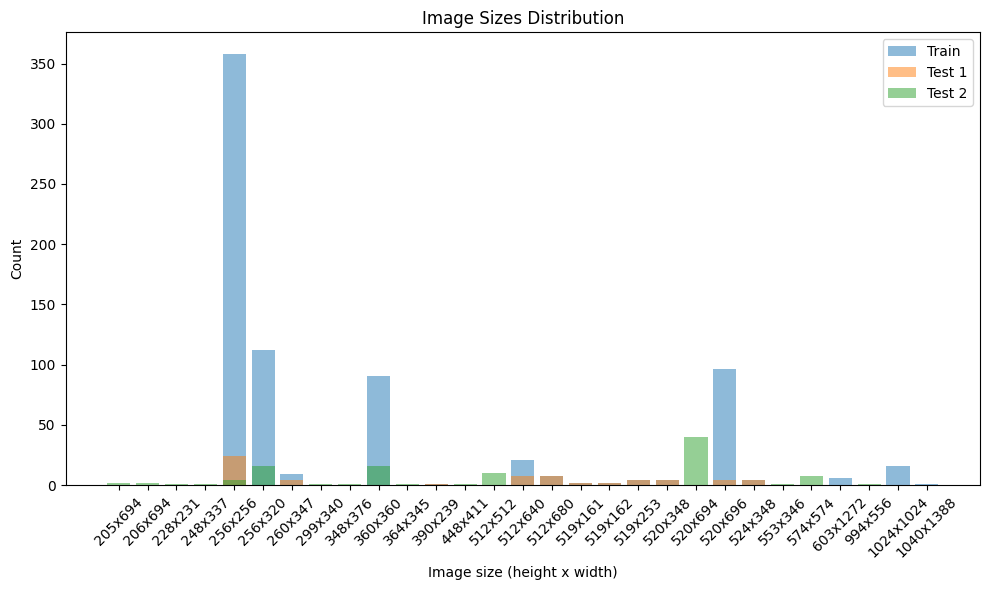

Most common size in Train set: (256, 256)
Most common size in Test 1 set: (256, 256)
Most common size in Test 2 set: (520, 694)
Most common size in Overall: (256, 256)


(256, 256)

In [11]:
analyze_data(train_images, test_1_images, test_2_images)

> # 6. Preprocess the data

In [39]:
from skimage.transform import resize
from skimage.color import rgb2gray

def preprocess(image, shape, param=False):
    processed_image = None

    if shape[2] == 3:
        if len(image.shape) == 3 and image.shape[2] >= shape[2]:
            processed_image = resize(image[:, :, :shape[2]], (shape[0], shape[1])).astype(np.float32)
        else:
            print(image.shape)
            processed_image = np.repeat(image[:, :, np.newaxis], 3, axis=-1)
            print(processed_image.shape)
            processed_image = resize(processed_image[:, :, :shape[2]], (shape[0], shape[1])).astype(np.float32)

    if shape[2] == 1:
        processed_image = resize(image, (shape[0], shape[1])).astype(np.float32)
        if param == False:
            processed_image = np.expand_dims(processed_image, axis=-1)

    return processed_image.astype(np.float32)

def preprocess_data(train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks):
    train_images = np.array([preprocess(image, IMAGE_SHAPE) for image in tqdm(train_images, desc='Preprocess train images')])
    test_1_images = np.array([preprocess(image, IMAGE_SHAPE) for image in tqdm(test_1_images, desc='Preprocess test images (stage 1)')])
    test_2_images = np.array([preprocess(image, IMAGE_SHAPE) for image in tqdm(test_2_images, desc='Preprocess test images (stage 2)')])
    train_masks = np.array([preprocess(mask, MASK_SHAPE) for mask in tqdm(train_masks , desc='Preprocess train masks')])
    test_1_masks = np.array([preprocess(mask, MASK_SHAPE) for mask in tqdm(test_1_masks, desc='Preprocess test masks (stage 1)')])
    test_2_masks = np.array([preprocess(mask, MASK_SHAPE) for mask in tqdm(test_2_masks, desc='Preprocess test masks (stage 2)')])
    return train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks


In [40]:
pp_train_images, pp_test_1_images, pp_test_2_images, pp_train_masks, pp_test_1_masks, pp_test_2_masks = preprocess_data(train_images, test_1_images, test_2_images, train_masks, test_1_masks, test_2_masks)

Preprocess train images:   0%|          | 0/735 [00:00<?, ?it/s]

Preprocess test images (stage 1):   0%|          | 0/65 [00:00<?, ?it/s]

Preprocess test images (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

Preprocess train masks:   0%|          | 0/735 [00:00<?, ?it/s]

Preprocess test masks (stage 1):   0%|          | 0/65 [00:00<?, ?it/s]

Preprocess test masks (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

> # 7. Visualize preprocessed data

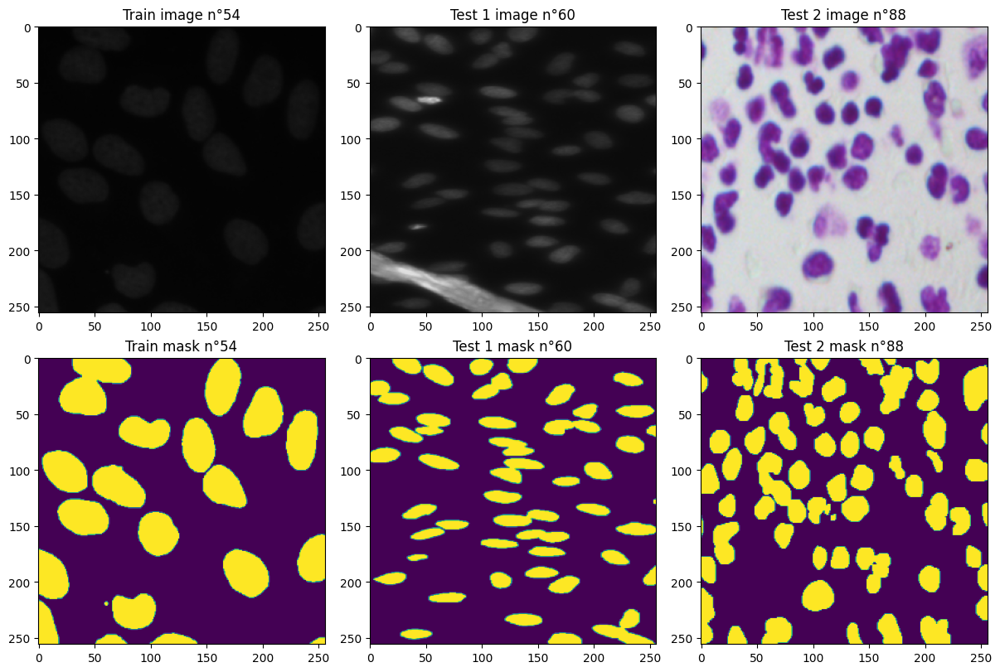

In [43]:
plot_images(pp_train_images, pp_train_masks, pp_test_1_images, pp_test_1_masks, pp_test_2_images, pp_test_2_masks)

> # 8. Setup train, val and test set

In [48]:
from sklearn.model_selection import train_test_split

def train_val_split(train_images, train_masks, ratio):
    return train_test_split(train_images, train_masks, test_size=ratio, random_state=0)

In [49]:
pp_train_images, pp_val_images, pp_train_masks, pp_val_masks = train_val_split(pp_train_images, pp_train_masks, ratio=0.3)

> # 9. Data augmentation

In [50]:
import random
from keras.preprocessing.image import ImageDataGenerator

def generate_augmented_data(train_images, train_masks, val_images, val_masks):
    img_data_gen_args = dict(rotation_range=90,
                        width_shift_range=0.3,
                        height_shift_range=0.3,
                        shear_range=0.3,
                        zoom_range=0.3,
                        horizontal_flip=True,
                        vertical_flip=True,
                        fill_mode='reflect'
                        )

    mask_data_gen_args = dict(rotation_range=90,
                        width_shift_range=0.3,
                        height_shift_range=0.3,
                        shear_range=0.3,
                        zoom_range=0.3,
                        horizontal_flip=True,
                        vertical_flip=True,
                        fill_mode='reflect',
                        preprocessing_function = lambda x: np.where(x>0, 1, 0).astype(x.dtype))

    # Data augmentation
    image_data_generator = ImageDataGenerator(**img_data_gen_args)
    mask_data_generator = ImageDataGenerator(**mask_data_gen_args)

    # Data augmentation
    image_data_generator.fit(train_images, augment=True, seed=SEED)
    mask_data_generator.fit(train_masks, augment=True, seed=SEED)

    # Train
    train_image_generator = image_data_generator.flow(train_images, batch_size=BATCH_SIZE, shuffle=True, seed=SEED)
    train_mask_generator = mask_data_generator.flow(train_masks, batch_size=BATCH_SIZE, shuffle=True, seed=SEED)

    # Val
    val_image_generator = image_data_generator.flow(val_images, batch_size=BATCH_SIZE, shuffle=True, seed=SEED)
    val_mask_generator = mask_data_generator.flow(val_masks, batch_size=BATCH_SIZE, shuffle=True, seed=SEED)

    # Generator
    train_generator = zip(train_image_generator, train_mask_generator)
    val_generator = zip(val_image_generator, val_mask_generator)

    steps_per_epoch = 2*len(train_image_generator)
    validation_steps = 2*len(val_image_generator)

    print('Batch size: ', BATCH_SIZE)
    print('Steps per epoch: ', steps_per_epoch)
    print('Validation steps: ', validation_steps)

    return train_generator, val_generator, steps_per_epoch, validation_steps

In [51]:
train_generator, val_generator, steps_per_epoch, validation_steps = generate_augmented_data(pp_train_images, pp_train_masks, pp_val_images, pp_val_masks)

Batch size:  32
Steps per epoch:  34
Validation steps:  14


> # 10. Visualize augmented data

In [54]:
def visualize_augmented_data(train_generator, val_generator, steps_per_epoch, validation_steps):
    batch_size = BATCH_SIZE
    num_cols = 4

    @interact(batch_num=IntSlider(min=0, max=min(steps_per_epoch - 1, validation_steps - 1), continuous_update=False, description='Batch number'))
    def update_plot(batch_num):
        fig, axes = plt.subplots(8, 8, figsize=(32, 32))


        for i, (train_images_batch, _) in enumerate(train_generator):
            if i == batch_num:
                break

        for i, (val_images_batch, _) in enumerate(val_generator):
            if i == batch_num:
                break

        for i in range(batch_size):
            row = i // num_cols
            col = i % num_cols
            axes[row, col].imshow(train_images_batch[i])
            axes[row, col].set_title(f'Train image n°{i}')

            axes[row, col + num_cols].imshow(val_images_batch[i])
            axes[row, col + num_cols].set_title(f'Val image n°{i}')

        plt.show()

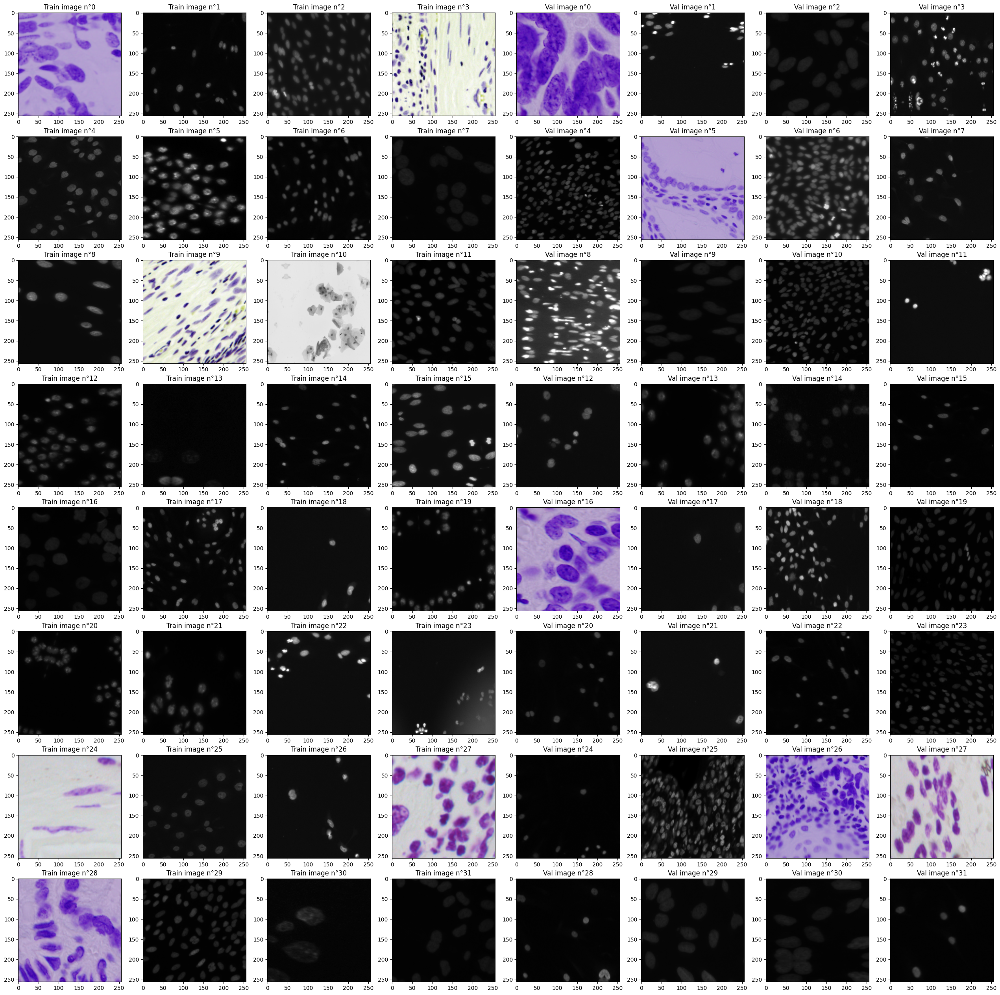

In [53]:
visualize_augmented_data(train_generator, val_generator, steps_per_epoch, validation_steps)

> # 11. U-Net model

In [58]:
!pip install tensorflow-addons
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Conv2DTranspose, BatchNormalization, Activation
from keras.layers import MaxPool2D
from keras.metrics import MeanIoU
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import Precision, Recall
from tensorflow_addons.metrics import F1Score
from tensorflow.keras.metrics import MeanIoU
!pip install segmentation-models
from tensorflow import keras
from keras.optimizers import Adam, SGD
import os
os.environ["SM_FRAMEWORK"] = "tf.keras"
import segmentation_models as sm
from segmentation_models.losses import bce_jaccard_loss, JaccardLoss, bce_dice_loss
from segmentation_models.metrics import IOUScore, FScore, Precision, Recall
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.models import load_model
import pandas as pd

# Convolution block
def conv_block(input, num_filters):
  x = Conv2D(num_filters, 3, padding="same")(input)
  x = BatchNormalization()(x)
  x = Activation("relu")(x)

  x = Conv2D(num_filters, 3, padding="same")(x)
  x = BatchNormalization()(x)
  x = Activation("relu")(x)

  return x

# Encoder block = convolution block + max pooling
def encoder_block(input, num_filters):
  x = conv_block(input, num_filters)
  p = MaxPooling2D((2, 2))(x)
  return x, p

# Decoder block = upsampling + concatenation + convolution block
def decoder_block(input, skip_features, num_filters):
  x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
  x = concatenate([x, skip_features])
  x = conv_block(x, num_filters)
  return x

def unet(input_shape):
  inputs = Input(input_shape)

  s1, p1 = encoder_block(inputs, 64)
  s2, p2 = encoder_block(p1, 128)
  s3, p3 = encoder_block(p2, 256)
  s4, p4 = encoder_block(p3, 512)

  b1 = conv_block(p4, 1024)

  d1 = decoder_block(b1, s4, 512)
  d2 = decoder_block(d1, s3, 256)
  d3 = decoder_block(d2, s2, 128)
  d4 = decoder_block(d3, s1, 64)

  outputs = Conv2D(1, 1, padding="same", activation="sigmoid")(d4)

  model = Model(inputs, outputs, name="U-Net")
  return model

def jaccard_loss(y_true, y_pred):
    intersection = tf.reduce_sum(y_true * y_pred, axis=(1,2))
    union = tf.reduce_sum(y_true + y_pred, axis=(1,2)) - intersection
    jaccard = (intersection + 1e-15) / (union + 1e-15)
    return 1 - tf.reduce_mean(jaccard)

def unet_model():
    model = unet(INPUT_SHAPE)
    model.compile(optimizer=Adam(), loss=jaccard_loss, metrics=[IoU(), 'accuracy', Precision(), Recall(), F1Score()])
    # model.summary()
    return model

def modified_unet_model():
    model = sm.Unet('resnet152')
    model.compile(optimizer=Adam(), loss = JaccardLoss(), metrics=[IOUScore(), 'accuracy', FScore(beta=1), Precision(), Recall()])
    # model.summary()
    return model

def save_history(history, file_path):
    history_df = pd.DataFrame(history.history)
    history_df.to_csv(file_path, index=False)
    history = history_df.to_dict(orient='list')
    return history

def train_model(model, train_generator, val_generator, steps_per_epoch, validation_steps, path):
    checkpoint_callback = ModelCheckpoint(monitor='val_loss', filepath=f'model_checkpoint_{EPOCHS}.h5', save_best_only=True)
    history = model.fit_generator(train_generator,
                                validation_data=val_generator,
                                steps_per_epoch=steps_per_epoch,
                                validation_steps=validation_steps,
                                epochs=EPOCHS,
                                callbacks=[checkpoint_callback])

    if not os.path.exists(path):
        model.save(path)
        history = save_history(history, SAVE_HISTORY_PATH)
    else:
        print(f"Model already exists at {path}. Skipping saving.")
    return history

def load_history(file_path):
    history_df = pd.read_csv(file_path)
    history = history_df.to_dict(orient='list')
    return history

def load_unet_model(model_path, history_path):
    model = load_model(model_path, compile=False)
    history = load_history(history_path)
    return model, history

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 3.3 MB/s eta 0:00:00
Segmentation Models: using `tf.keras` framework.


In [22]:
parameter = 'load'
model = None
history = None
if parameter == 'train':
    model = modified_unet_model()
    history = train_model(model, train_generator, val_generator, steps_per_epoch, validation_steps, SAVE_MODEL_PATH)
else:
    model, history = load_unet_model(BEST_MODEL_PATH, BEST_HISTORY_PATH) #Take some time ~10 min so take a break

234326024/234326024 [==============================] - 1s 0us/step
Epoch 1/100
34/34 [==============================] - 117s 1s/step - loss: 0.8428 - iou_score: 0.1563 - accuracy: 0.5705 - f1-score: 0.2688 - precision: 0.1869 - recall: 0.5020 - val_loss: 0.8397 - val_iou_score: 0.1606 - val_accuracy: 0.7623 - val_f1-score: 0.2764 - val_precision: 0.1948 - val_recall: 0.4805
Epoch 2/100
34/34 [==============================] - 31s 912ms/step - loss: 0.8285 - iou_score: 0.1725 - accuracy: 0.5538 - f1-score: 0.2936 - precision: 0.1996 - recall: 0.5666 - val_loss: 0.8381 - val_iou_score: 0.1620 - val_accuracy: 0.6817 - val_f1-score: 0.2784 - val_precision: 0.1974 - val_recall: 0.4792
Epoch 3/100
34/34 [==============================] - 29s 846ms/step - loss: 0.8045 - iou_score: 0.1941 - accuracy: 0.5889 - f1-score: 0.3239 - precision: 0.2195 - recall: 0.6371 - val_loss: 0.8438 - val_iou_score: 0.1562 - val_accuracy: 0.7908 - val_f1-score: 0.2699 - val_precision: 0.1969 - val_recall: 0.4327

> # 12. Visualize model history

In [60]:
def print_plot_history(history):
    plt.figure(figsize=(18, 12))

    plt.subplot(2, 2, 1)
    plt.plot(history['iou_score'], label='Train Iou')
    plt.plot(history['loss'], label='Train Loss')
    plt.title('Training Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.ylim(0, 1)
    plt.legend()

    plt.subplot(2, 2, 2)
    plt.plot(history['val_iou_score'], label='Val Iou')
    plt.plot(history['val_loss'], label='Val Loss')
    plt.title('Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.ylim(0, 1)
    plt.legend()

    plt.subplot(2, 2, 3)
    plt.plot(history['accuracy'], label='Train Accuracy')
    plt.plot(history['precision'], label='Train Precision')
    plt.plot(history['recall'], label='Train Recall')
    plt.plot(history['f1-score'], label='Train F1 Score')
    plt.title('Training Metrics')
    plt.xlabel('Epochs')
    plt.ylabel('Metrics')
    plt.ylim(0, 1)
    plt.legend()

    plt.subplot(2, 2, 4)
    plt.plot(history['val_accuracy'], label='Val Accuracy')
    plt.plot(history['val_precision'], label='Val Precision')
    plt.plot(history['val_recall'], label='Val Recall')
    plt.plot(history['val_f1-score'], label='Val F1 Score')
    plt.title('Validation Metrics')
    plt.xlabel('Epochs')
    plt.ylabel('Metrics')
    plt.ylim(0, 1)
    plt.legend()
    plt.tight_layout()
    plt.show()

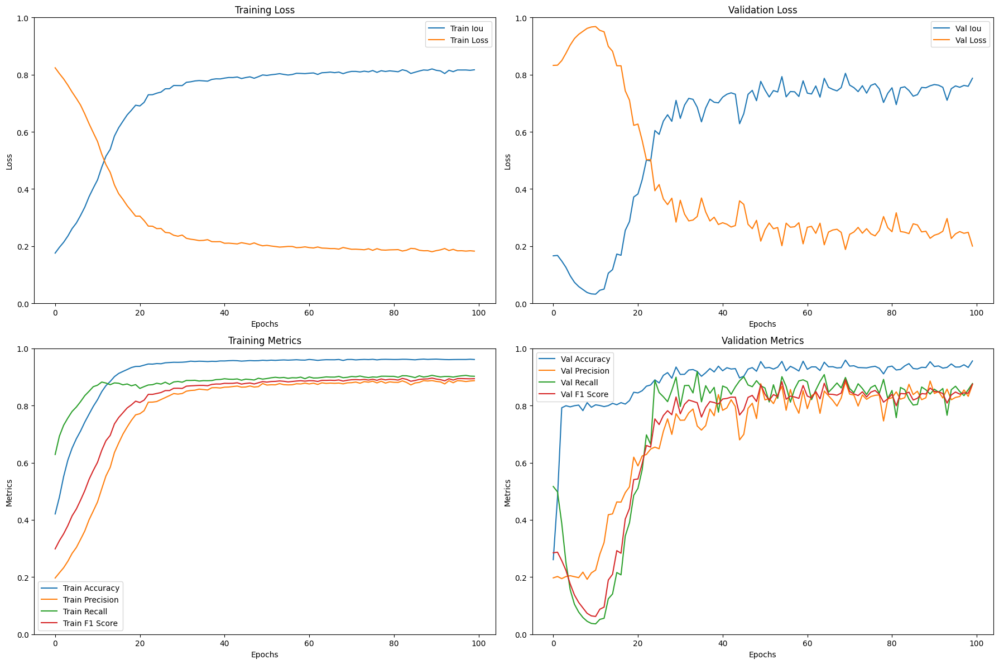

In [61]:
print_plot_history(history)

> # 13. Test time augmentation (TTA)

In [62]:
from skimage.filters import threshold_otsu

def tta(model, images):
    tta_masks = []
    for image in tqdm(images, desc='TTA for test images (stage 2)'):
        tta_predictions = []
        original_prediction = model.predict(np.expand_dims(image, axis=0), verbose=0)
        tta_predictions.append(np.squeeze(original_prediction))

        for angle in range(90, 360, 90):
            rotated_image = np.rot90(image, k=angle // 90)
            rotated_prediction = model.predict(np.expand_dims(rotated_image, axis=0), verbose=0)
            tta_predictions.append(np.rot90(np.squeeze(rotated_prediction), k=-angle // 90))

        # Horizontal flip
        horizontal_flip = np.fliplr(image)
        horizontal_flip_prediction = model.predict(np.expand_dims(horizontal_flip, axis=0), verbose=0)
        tta_predictions.append(np.fliplr(np.squeeze(horizontal_flip_prediction)))

        # Vertical flip
        # vertical_flip = np.flipud(image)
        # vertical_flip_prediction = model.predict(np.expand_dims(vertical_flip, axis=0), verbose=0)
        # tta_predictions.append(np.flipud(np.squeeze(vertical_flip_prediction)))

        # Mean aggregation
        mean_prediction = np.expand_dims(np.mean(tta_predictions, axis=0), axis=-1)

        # Thresholding (example using Otsu's method)
        mean_mask = (mean_prediction > threshold_otsu(mean_prediction)).astype(np.uint8)

        tta_masks.append(mean_mask)

    return np.array(tta_masks)

In [63]:
# test_1_pred_masks = tta(model, test_1_images)
test_2_pred_masks = tta(model, pp_test_2_images)

TTA for test images (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

> # 14. Post processing

In [64]:
import numpy as np
from skimage import morphology, measure, color, segmentation
from scipy.ndimage import distance_transform_edt
from skimage.filters import threshold_otsu, threshold_multiotsu
from skimage import morphology
from skimage import segmentation
from skimage.color import rgb2gray, rgb2hsv
from skimage.filters import sobel,gaussian
from skimage.feature import peak_local_max
from scipy.ndimage import distance_transform_edt, binary_fill_holes
from skimage.filters.rank import gradient
from skimage.morphology import disk, closing, binary_opening, opening, binary_dilation, binary_erosion, binary_closing, thin, erosion
from skimage.segmentation import watershed, mark_boundaries, random_walker, clear_border, join_segmentations
import skimage.morphology

def post_proccess_masks(test_pred_masks):
    test_pp_masks = []
    for idx, mask in enumerate(tqdm(test_pred_masks, desc='Post processing of predictions')):
        mask = np.squeeze(mask)
        mask = mask > threshold_otsu(mask)
        mask = binary_fill_holes(mask).astype(np.uint8)
        regions = regionprops(label(mask))
        radii = []
        for region in regions:
            radius = np.sqrt(region.area / np.pi)
            radii.append(radius)
        average_radius = int(round(np.mean(radii)))
        distance = distance_transform_edt(mask)
        markers = label(peak_local_max(distance, min_distance=average_radius, footprint=disk(average_radius), threshold_rel=0.2, indices=False, exclude_border=False)) #min distance to determine
        wsh = watershed(-distance, markers, mask=mask)
        # markers[mask == 0] = -1
        # rw = random_walker(mask, markers)
        # rw[rw <= 0] = 0
        test_pp_masks.append(wsh)

    return np.array(test_pp_masks)

def post_proccess_masks_2(test_pred_masks, markers):
    test_pp_masks = []
    for idx, mask in enumerate(test_pred_masks):
        mask = np.squeeze(mask)
        distance = distance_transform_edt(mask)
        m2 = markers[idx]
        wsh = watershed(-distance, m2, mask=mask)
        # markers[mask == 0] = -1
        # rw = random_walker(mask, markers)
        # rw[rw <= 0] = 0
        test_pp_masks.append(wsh)

    return np.array(test_pp_masks)

In [65]:
# test_1_pp_masks = post_proccess_masks(test_1_pred_masks)
test_2_pp_masks = post_proccess_masks(test_2_pred_masks)

Post processing of predictions:   0%|          | 0/106 [00:00<?, ?it/s]

<ipython-input-64-65e60a6ef4bd>:29: FutureWarning: indices argument is deprecated and will be removed in version 0.20. To avoid this warning, please do not use the indices argument. Please see peak_local_max documentation for more details.
  markers = label(peak_local_max(distance, min_distance=average_radius, footprint=disk(average_radius), threshold_rel=0.2, indices=False, exclude_border=False)) #min distance to determine


> # 15. Load solution

In [66]:
def labeled_mask(id):
    masks_paths = glob(id + '/masks/*.png')
    masks =  np.array([read_image(mask_path) for mask_path in masks_paths])
    masks = np.array([preprocess(mask, MASK_SHAPE, param=True) for mask in masks])
    num_masks, height, width = masks.shape
    labeled_mask = np.zeros((height, width), np.uint16)
    for index in range(0, num_masks):
        labeled_mask[masks[index] > 0] = index + 1
    return labeled_mask

def markers(id):
    masks_paths = glob(id + '/masks/*.png')
    masks = np.array([read_image(mask_path) for mask_path in masks_paths])
    markers = []
    for mask in masks:
        mask = preprocess(mask, MASK_SHAPE, param=True)
        labeled_mask = label(mask)
        regions = regionprops(labeled_mask)
        for region in regions:
            center_row, center_col = region.centroid
            markers.append([center_row, center_col])
    markers = np.array(markers)
    return markers

def load_solution(test_1_path, test_2_path):
    test_1_image_paths = sorted(glob(test_1_path + '*/images/*.png'))
    test_2_image_paths = sorted(glob(test_2_path + '*/images/*.png'))

    test_1_ids = [path.rsplit('/', 2)[0] for path in test_1_image_paths]
    test_2_ids = [path.rsplit('/', 2)[0] for path in test_2_image_paths]

    test_1_labels = [labeled_mask(id) for id in tqdm(test_1_ids, desc='Test labels (stage 1)')]
    test_2_labels = [labeled_mask(id) for id in tqdm(test_2_ids, desc='Test labels (stage 2)')]

    test_1_markers = [markers(id) for id in tqdm(test_1_ids, desc='Test markers (stage 1)')]
    test_2_markers = [markers(id) for id in tqdm(test_2_ids, desc='Test markers (stage 2)')]

    return test_1_labels, test_2_labels, test_1_markers, test_2_markers

In [67]:
test_1_labels, test_2_labels, test_1_markers, test_2_markers = load_solution(TEST_1_PATH, TEST_2_PATH)

Test labels (stage 1):   0%|          | 0/65 [00:00<?, ?it/s]

Test labels (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

Test markers (stage 1):   0%|          | 0/65 [00:00<?, ?it/s]

Test markers (stage 2):   0%|          | 0/106 [00:00<?, ?it/s]

> # 16. Evaluation

In [68]:
import matplotlib.pyplot as plt
from skimage.measure import label

# https://www.kaggle.com/code/wcukierski/example-metric-implementation
def precision_at(threshold, iou):
    matches = iou > threshold
    true_positives = np.sum(matches, axis=1) == 1   # Correct objects
    false_positives = np.sum(matches, axis=0) == 0  # Missed objects
    false_negatives = np.sum(matches, axis=1) == 0  # Extra objects
    tp, fp, fn = np.sum(true_positives), np.sum(false_positives), np.sum(false_negatives)
    return tp, fp, fn

def score(masks, pred, verbose=True):
    labels = masks
    y_pred = pred

    # Compute number of objects
    true_objects = len(np.unique(labels)) # Background = 0
    pred_objects = len(np.unique(y_pred)) # Background = 0
    if verbose:
        print("Number of true objects:", true_objects - 1)
        print("Number of predicted objects:", pred_objects - 1)

    # Compute intersection between all objects
    intersection = np.histogram2d(labels.flatten(), y_pred.flatten(), bins=(true_objects, pred_objects))[0]

    # Compute areas (needed for finding the union between all objects)
    area_true = np.histogram(labels, bins = true_objects)[0]
    area_pred = np.histogram(y_pred, bins = pred_objects)[0]
    area_true = np.expand_dims(area_true, -1)
    area_pred = np.expand_dims(area_pred, 0)

    # Compute union
    union = area_true + area_pred - intersection

    # Exclude background from the analysis
    intersection = intersection[1:,1:]
    union = union[1:,1:]
    union[union == 0] = 1e-9

    # Compute the intersection over union
    iou = intersection / union

    # Loop over IoU thresholds
    prec = []

    if verbose:
        print("Thresh\tTP\tFP\tFN\tPrec.")

    for t in np.arange(0.5, 1.0, 0.05):
        tp, fp, fn = precision_at(t, iou)
        p = tp / (tp + fp + fn)
        if verbose:
            print("{:1.3f}\t{}\t{}\t{}\t{:1.3f}".format(t, tp, fp, fn, p))
        prec.append(p)

    if verbose:
        print("AP\t-\t-\t-\t{:1.3f}".format(np.mean(prec)))

    return np.mean(prec)

> # 17. Results

In [69]:
from matplotlib.colors import LinearSegmentedColormap

def show_results(images, gt_masks, labels, pred_masks, pp_masks, verbose=True):
    colors = [(0, 0, 1), (1, 1, 1), (1, 0, 0)]  # (blue, white, red)
    cmap_name = 'custom_cmap'
    cm = LinearSegmentedColormap.from_list(cmap_name, colors)

    scores = []
    for idx, (image, gt_mask, pred_mask, pp_mask) in enumerate(zip(images, gt_masks, pred_masks, pp_masks)):
        if verbose:
            fig, ax = plt.subplots(1, 4, figsize=(20, 20))

            ax[0].set_title(f'Image n°{idx}')
            ax[0].imshow(image)

            ax[1].set_title(f'Ground truth mask n°{idx}')
            ax[1].imshow(gt_mask)

            ax[2].set_title(f'Post processed mask n°{idx}')
            ax[2].imshow(np.expand_dims(pp_mask, axis=-1))

            a = np.squeeze(gt_masks[idx]) - (pp_masks[idx] > 0).astype(np.uint8)
            ax[3].set_title('Differences')
            ax[3].imshow(a, cmap=cm, vmin=-1, vmax=1)

        a = labels[idx]
        b = label(pp_mask)
        score_i = score(a, b, verbose=verbose)
        scores.append(score_i)
        plt.show()

    print(f'LB = {np.mean(scores)}')

Number of true objects: 16
Number of predicted objects: 15
Thresh	TP	FP	FN	Prec.
0.500	14	1	2	0.824
0.550	14	1	2	0.824
0.600	14	1	2	0.824
0.650	14	1	2	0.824
0.700	14	1	2	0.824
0.750	14	1	2	0.824
0.800	14	1	2	0.824
0.850	14	1	2	0.824
0.900	14	1	2	0.824
0.950	9	6	7	0.409
AP	-	-	-	0.782


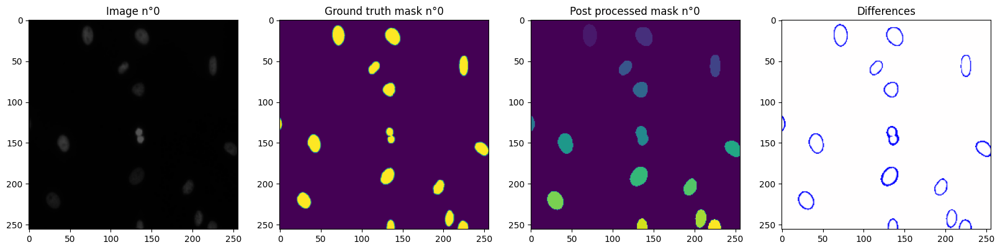

Number of true objects: 36
Number of predicted objects: 29
Thresh	TP	FP	FN	Prec.
0.500	20	9	16	0.444
0.550	20	9	16	0.444
0.600	17	12	19	0.354
0.650	17	12	19	0.354
0.700	15	14	21	0.300
0.750	14	15	22	0.275
0.800	12	17	24	0.226
0.850	7	22	29	0.121
0.900	1	28	35	0.016
0.950	0	29	36	0.000
AP	-	-	-	0.253


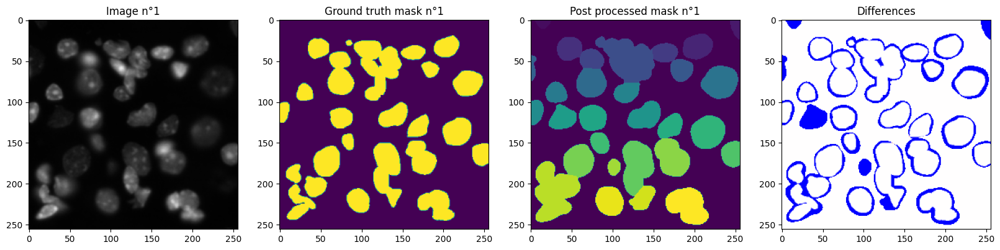

Number of true objects: 44
Number of predicted objects: 34
Thresh	TP	FP	FN	Prec.
0.500	25	9	19	0.472
0.550	22	12	22	0.393
0.600	22	12	22	0.393
0.650	21	13	23	0.368
0.700	18	16	26	0.300
0.750	18	16	26	0.300
0.800	18	16	26	0.300
0.850	14	20	30	0.219
0.900	7	27	37	0.099
0.950	1	33	43	0.013
AP	-	-	-	0.286


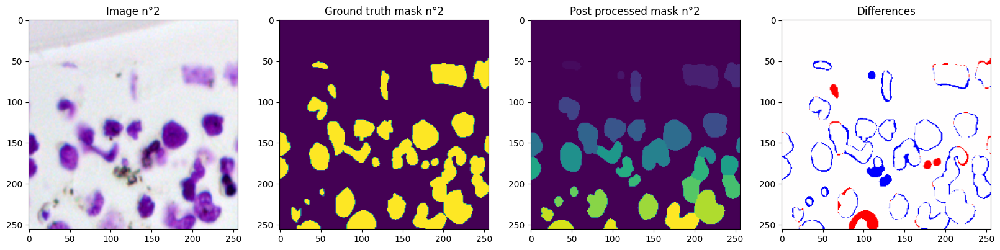

Number of true objects: 3
Number of predicted objects: 3
Thresh	TP	FP	FN	Prec.
0.500	3	0	0	1.000
0.550	3	0	0	1.000
0.600	3	0	0	1.000
0.650	3	0	0	1.000
0.700	3	0	0	1.000
0.750	3	0	0	1.000
0.800	3	0	0	1.000
0.850	3	0	0	1.000
0.900	3	0	0	1.000
0.950	0	3	3	0.000
AP	-	-	-	0.900


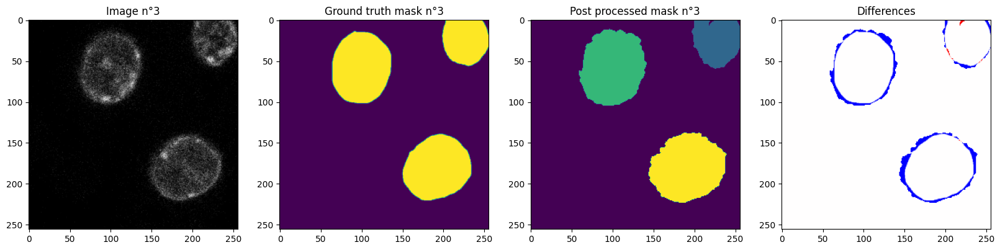

Number of true objects: 20
Number of predicted objects: 22
Thresh	TP	FP	FN	Prec.
0.500	19	3	1	0.826
0.550	19	3	1	0.826
0.600	19	3	1	0.826
0.650	19	3	1	0.826
0.700	19	3	1	0.826
0.750	17	5	3	0.680
0.800	16	6	4	0.615
0.850	10	12	10	0.312
0.900	3	19	17	0.077
0.950	0	22	20	0.000
AP	-	-	-	0.582


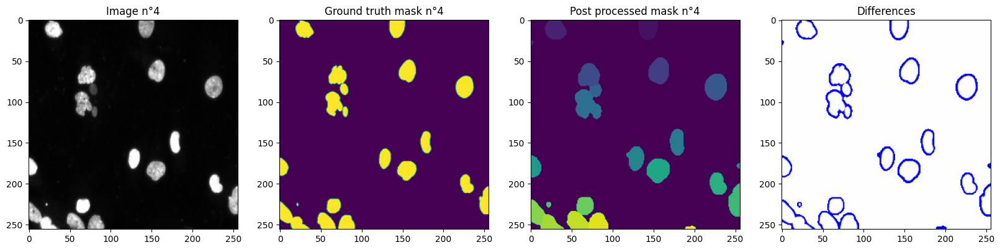

Number of true objects: 3
Number of predicted objects: 3
Thresh	TP	FP	FN	Prec.
0.500	3	0	0	1.000
0.550	3	0	0	1.000
0.600	3	0	0	1.000
0.650	3	0	0	1.000
0.700	3	0	0	1.000
0.750	3	0	0	1.000
0.800	3	0	0	1.000
0.850	3	0	0	1.000
0.900	3	0	0	1.000
0.950	2	1	1	0.500
AP	-	-	-	0.950


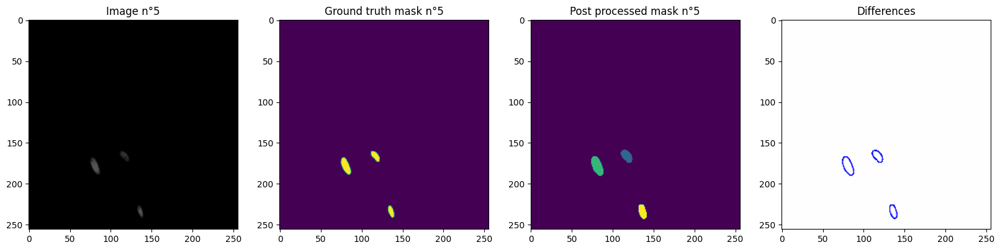

Number of true objects: 23
Number of predicted objects: 18
Thresh	TP	FP	FN	Prec.
0.500	16	2	7	0.640
0.550	16	2	7	0.640
0.600	16	2	7	0.640
0.650	16	2	7	0.640
0.700	15	3	8	0.577
0.750	15	3	8	0.577
0.800	15	3	8	0.577
0.850	15	3	8	0.577
0.900	14	4	9	0.519
0.950	11	7	12	0.367
AP	-	-	-	0.575


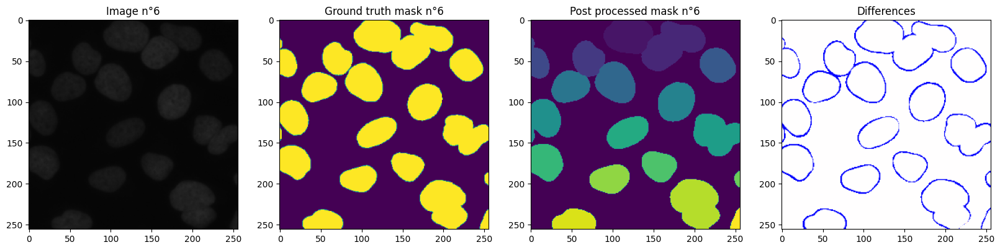

Number of true objects: 72
Number of predicted objects: 60
Thresh	TP	FP	FN	Prec.
0.500	52	8	20	0.650
0.550	48	12	24	0.571
0.600	47	13	25	0.553
0.650	46	14	26	0.535
0.700	44	16	28	0.500
0.750	41	19	31	0.451
0.800	39	21	33	0.419
0.850	30	30	42	0.294
0.900	13	47	59	0.109
0.950	3	57	69	0.023
AP	-	-	-	0.411


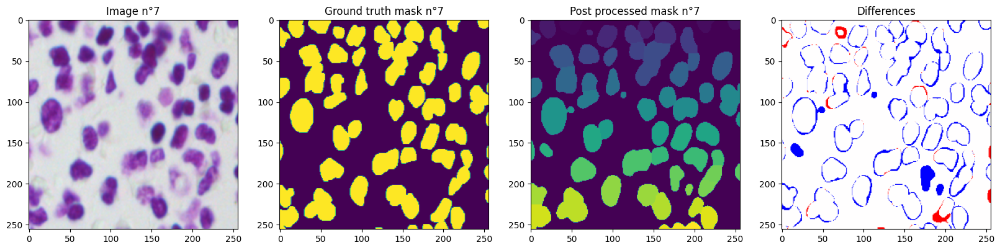

Number of true objects: 50
Number of predicted objects: 32
Thresh	TP	FP	FN	Prec.
0.500	26	6	24	0.464
0.550	26	6	24	0.464
0.600	22	10	28	0.367
0.650	21	11	29	0.344
0.700	21	11	29	0.344
0.750	20	12	30	0.323
0.800	15	17	35	0.224
0.850	11	21	39	0.155
0.900	4	28	46	0.051
0.950	0	32	50	0.000
AP	-	-	-	0.274


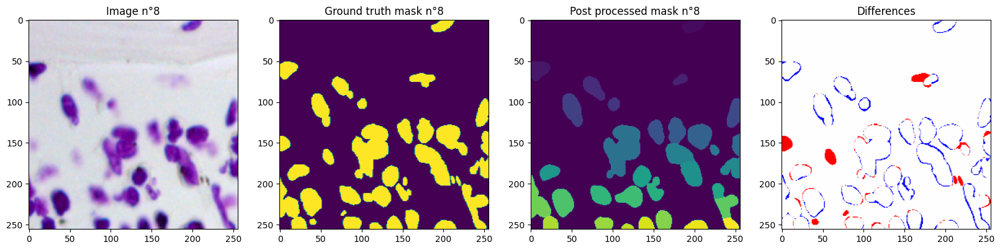

Number of true objects: 36
Number of predicted objects: 36
Thresh	TP	FP	FN	Prec.
0.500	34	2	2	0.895
0.550	34	2	2	0.895
0.600	32	4	4	0.800
0.650	32	4	4	0.800
0.700	32	4	4	0.800
0.750	19	17	17	0.358
0.800	6	30	30	0.091
0.850	1	35	35	0.014
0.900	0	36	36	0.000
0.950	0	36	36	0.000
AP	-	-	-	0.465


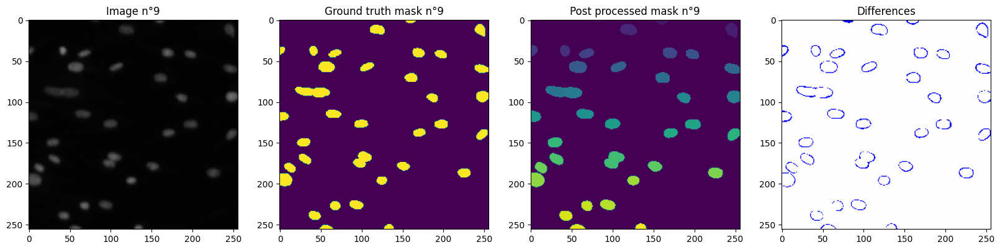

Number of true objects: 6
Number of predicted objects: 6
Thresh	TP	FP	FN	Prec.
0.500	6	0	0	1.000
0.550	6	0	0	1.000
0.600	6	0	0	1.000
0.650	6	0	0	1.000
0.700	6	0	0	1.000
0.750	6	0	0	1.000
0.800	6	0	0	1.000
0.850	6	0	0	1.000
0.900	6	0	0	1.000
0.950	2	4	4	0.200
AP	-	-	-	0.920


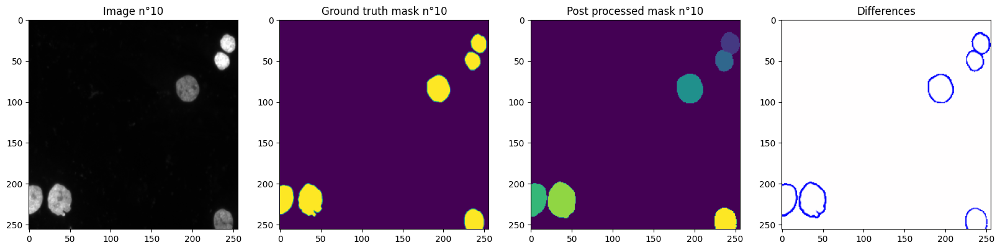

Number of true objects: 21
Number of predicted objects: 22
Thresh	TP	FP	FN	Prec.
0.500	19	3	2	0.792
0.550	17	5	4	0.654
0.600	15	7	6	0.536
0.650	13	9	8	0.433
0.700	11	11	10	0.344
0.750	10	12	11	0.303
0.800	10	12	11	0.303
0.850	9	13	12	0.265
0.900	5	17	16	0.132
0.950	1	21	20	0.024
AP	-	-	-	0.378


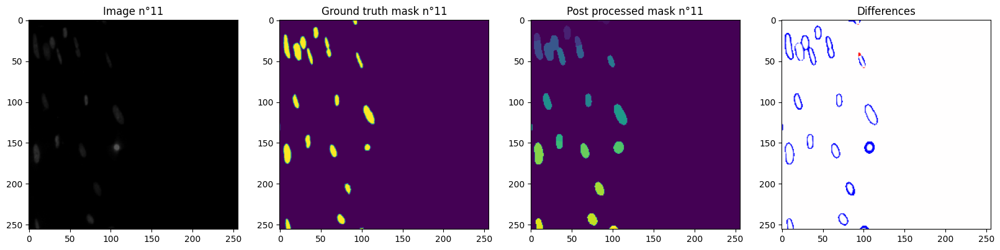

Number of true objects: 1
Number of predicted objects: 1
Thresh	TP	FP	FN	Prec.
0.500	1	0	0	1.000
0.550	1	0	0	1.000
0.600	1	0	0	1.000
0.650	1	0	0	1.000
0.700	1	0	0	1.000
0.750	1	0	0	1.000
0.800	1	0	0	1.000
0.850	1	0	0	1.000
0.900	1	0	0	1.000
0.950	0	1	1	0.000
AP	-	-	-	0.900


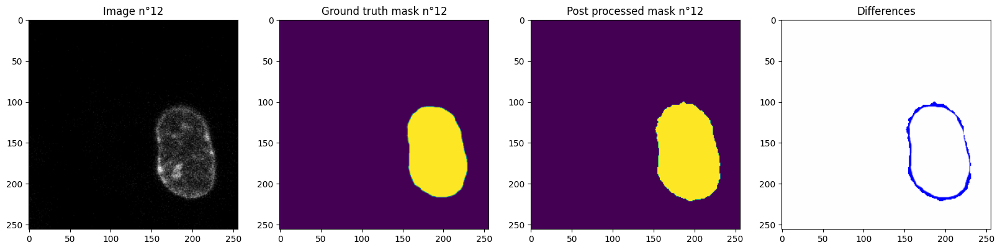

Number of true objects: 6
Number of predicted objects: 14
Thresh	TP	FP	FN	Prec.
0.500	4	10	2	0.250
0.550	4	10	2	0.250
0.600	4	10	2	0.250
0.650	4	10	2	0.250
0.700	4	10	2	0.250
0.750	4	10	2	0.250
0.800	3	11	3	0.176
0.850	2	12	4	0.111
0.900	1	13	5	0.053
0.950	1	13	5	0.053
AP	-	-	-	0.189


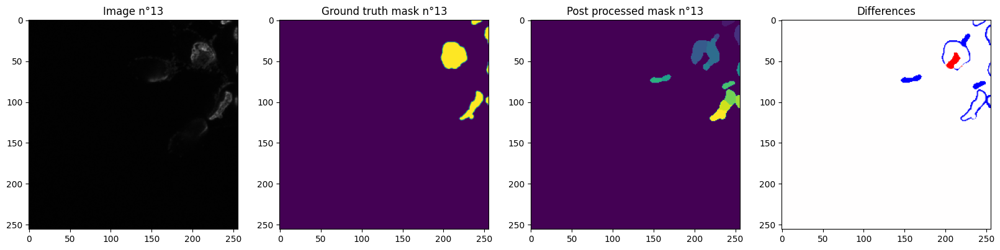

Number of true objects: 22
Number of predicted objects: 18
Thresh	TP	FP	FN	Prec.
0.500	18	0	4	0.818
0.550	18	0	4	0.818
0.600	18	0	4	0.818
0.650	18	0	4	0.818
0.700	18	0	4	0.818
0.750	18	0	4	0.818
0.800	18	0	4	0.818
0.850	17	1	5	0.739
0.900	17	1	5	0.739
0.950	12	6	10	0.429
AP	-	-	-	0.763


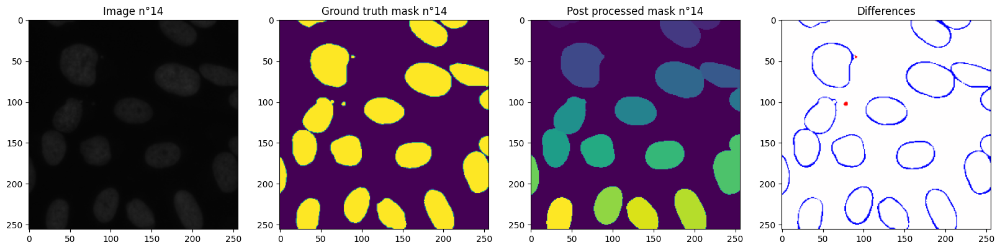

Number of true objects: 28
Number of predicted objects: 23
Thresh	TP	FP	FN	Prec.
0.500	23	0	5	0.821
0.550	23	0	5	0.821
0.600	23	0	5	0.821
0.650	23	0	5	0.821
0.700	23	0	5	0.821
0.750	23	0	5	0.821
0.800	22	1	6	0.759
0.850	22	1	6	0.759
0.900	21	2	7	0.700
0.950	9	14	19	0.214
AP	-	-	-	0.736


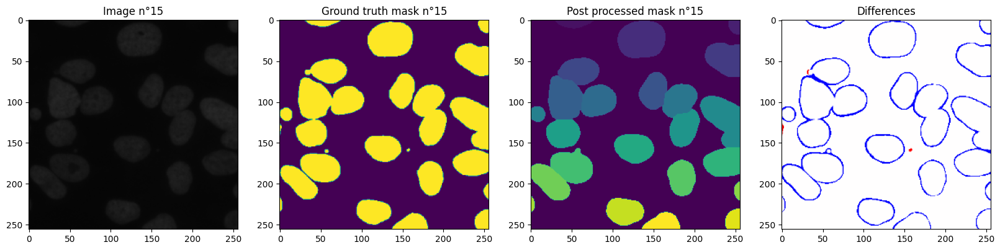

Number of true objects: 108
Number of predicted objects: 116
Thresh	TP	FP	FN	Prec.
0.500	30	86	78	0.155
0.550	17	99	91	0.082
0.600	11	105	97	0.052
0.650	2	114	106	0.009
0.700	1	115	107	0.004
0.750	0	116	108	0.000
0.800	0	116	108	0.000
0.850	0	116	108	0.000
0.900	0	116	108	0.000
0.950	0	116	108	0.000
AP	-	-	-	0.030


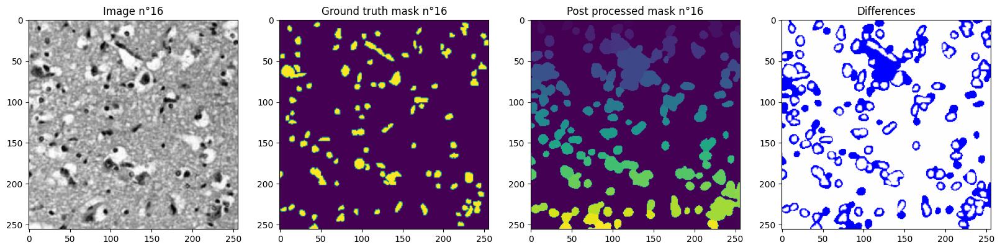

Number of true objects: 12
Number of predicted objects: 13
Thresh	TP	FP	FN	Prec.
0.500	10	3	2	0.667
0.550	10	3	2	0.667
0.600	10	3	2	0.667
0.650	10	3	2	0.667
0.700	10	3	2	0.667
0.750	10	3	2	0.667
0.800	10	3	2	0.667
0.850	8	5	4	0.471
0.900	3	10	9	0.136
0.950	1	12	11	0.042
AP	-	-	-	0.532


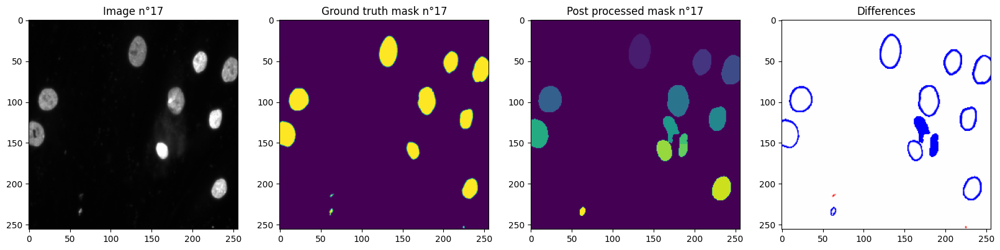

Number of true objects: 119
Number of predicted objects: 99
Thresh	TP	FP	FN	Prec.
0.500	78	21	41	0.557
0.550	77	22	42	0.546
0.600	75	24	44	0.524
0.650	70	29	49	0.473
0.700	61	38	58	0.389
0.750	43	56	76	0.246
0.800	27	72	92	0.141
0.850	12	87	107	0.058
0.900	5	94	114	0.023
0.950	0	99	119	0.000
AP	-	-	-	0.296


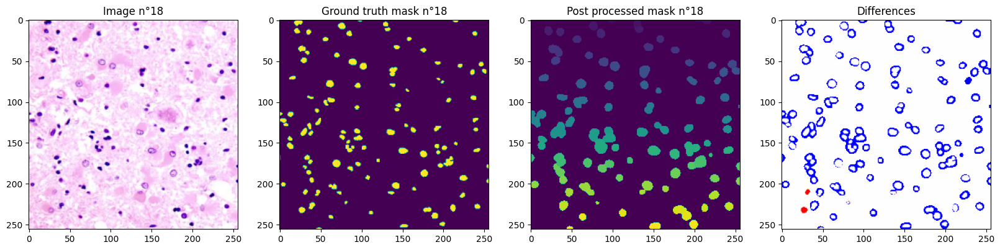

Number of true objects: 24
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	21	0	3	0.875
0.550	21	0	3	0.875
0.600	21	0	3	0.875
0.650	21	0	3	0.875
0.700	20	1	4	0.800
0.750	20	1	4	0.800
0.800	20	1	4	0.800
0.850	19	2	5	0.731
0.900	18	3	6	0.667
0.950	12	9	12	0.364
AP	-	-	-	0.766


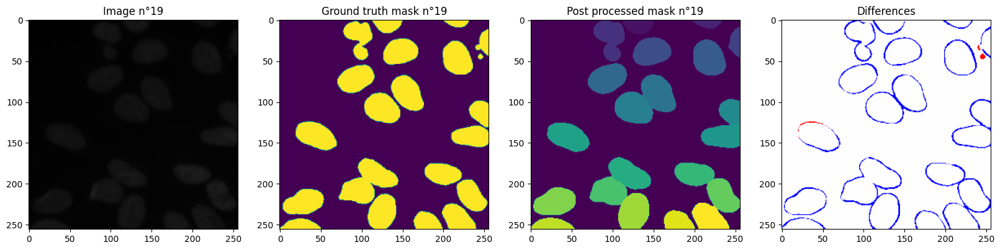

Number of true objects: 54
Number of predicted objects: 53
Thresh	TP	FP	FN	Prec.
0.500	39	14	15	0.574
0.550	35	18	19	0.486
0.600	31	22	23	0.408
0.650	31	22	23	0.408
0.700	31	22	23	0.408
0.750	31	22	23	0.408
0.800	30	23	24	0.390
0.850	28	25	26	0.354
0.900	22	31	32	0.259
0.950	8	45	46	0.081
AP	-	-	-	0.377


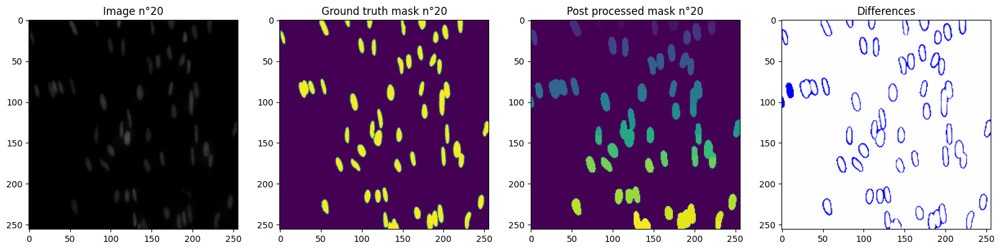

Number of true objects: 95
Number of predicted objects: 57
Thresh	TP	FP	FN	Prec.
0.500	52	5	43	0.520
0.550	49	8	46	0.476
0.600	46	11	49	0.434
0.650	43	14	52	0.394
0.700	38	19	57	0.333
0.750	34	23	61	0.288
0.800	34	23	61	0.288
0.850	27	30	68	0.216
0.900	17	40	78	0.126
0.950	1	56	94	0.007
AP	-	-	-	0.308


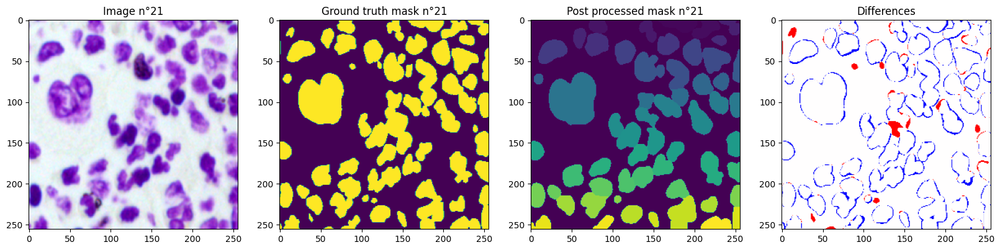

Number of true objects: 29
Number of predicted objects: 24
Thresh	TP	FP	FN	Prec.
0.500	24	0	5	0.828
0.550	24	0	5	0.828
0.600	24	0	5	0.828
0.650	23	1	6	0.767
0.700	23	1	6	0.767
0.750	23	1	6	0.767
0.800	23	1	6	0.767
0.850	22	2	7	0.710
0.900	22	2	7	0.710
0.950	12	12	17	0.293
AP	-	-	-	0.726


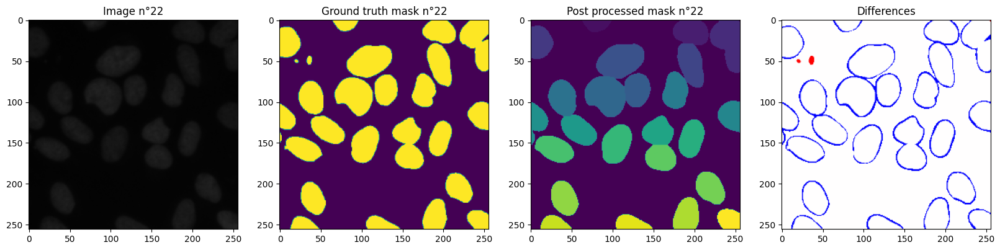

Number of true objects: 19
Number of predicted objects: 19
Thresh	TP	FP	FN	Prec.
0.500	19	0	0	1.000
0.550	19	0	0	1.000
0.600	19	0	0	1.000
0.650	19	0	0	1.000
0.700	18	1	1	0.900
0.750	18	1	1	0.900
0.800	18	1	1	0.900
0.850	17	2	2	0.810
0.900	14	5	5	0.583
0.950	4	15	15	0.118
AP	-	-	-	0.821


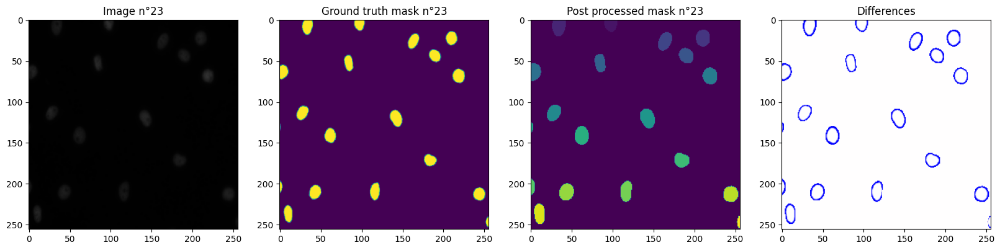

Number of true objects: 13
Number of predicted objects: 13
Thresh	TP	FP	FN	Prec.
0.500	13	0	0	1.000
0.550	13	0	0	1.000
0.600	13	0	0	1.000
0.650	13	0	0	1.000
0.700	13	0	0	1.000
0.750	13	0	0	1.000
0.800	12	1	1	0.857
0.850	12	1	1	0.857
0.900	11	2	2	0.733
0.950	3	10	10	0.130
AP	-	-	-	0.858


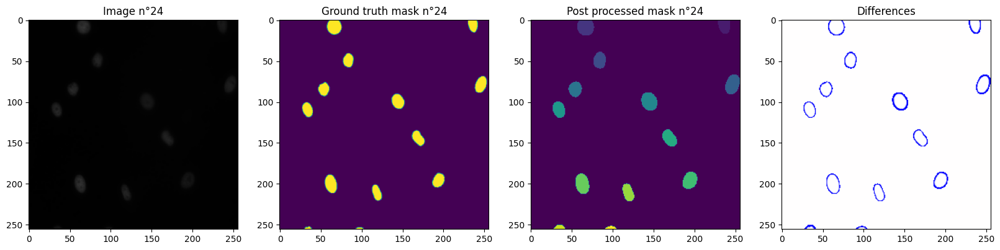

Number of true objects: 4
Number of predicted objects: 4
Thresh	TP	FP	FN	Prec.
0.500	4	0	0	1.000
0.550	4	0	0	1.000
0.600	4	0	0	1.000
0.650	3	1	1	0.600
0.700	3	1	1	0.600
0.750	3	1	1	0.600
0.800	3	1	1	0.600
0.850	2	2	2	0.333
0.900	2	2	2	0.333
0.950	0	4	4	0.000
AP	-	-	-	0.607


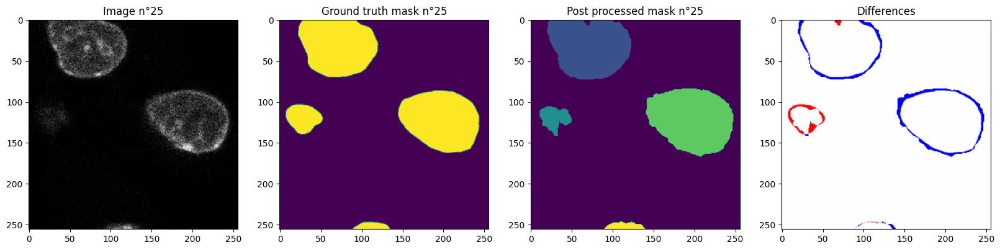

Number of true objects: 29
Number of predicted objects: 27
Thresh	TP	FP	FN	Prec.
0.500	27	0	2	0.931
0.550	25	2	4	0.806
0.600	25	2	4	0.806
0.650	25	2	4	0.806
0.700	25	2	4	0.806
0.750	25	2	4	0.806
0.800	25	2	4	0.806
0.850	24	3	5	0.750
0.900	17	10	12	0.436
0.950	5	22	24	0.098
AP	-	-	-	0.705


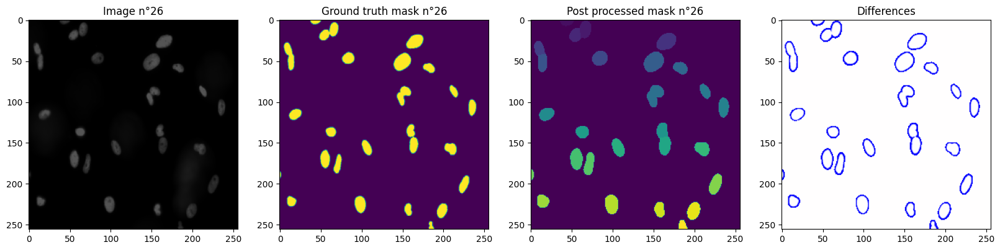

Number of true objects: 13
Number of predicted objects: 13
Thresh	TP	FP	FN	Prec.
0.500	13	0	0	1.000
0.550	13	0	0	1.000
0.600	13	0	0	1.000
0.650	13	0	0	1.000
0.700	13	0	0	1.000
0.750	13	0	0	1.000
0.800	13	0	0	1.000
0.850	11	2	2	0.733
0.900	4	9	9	0.182
0.950	0	13	13	0.000
AP	-	-	-	0.792


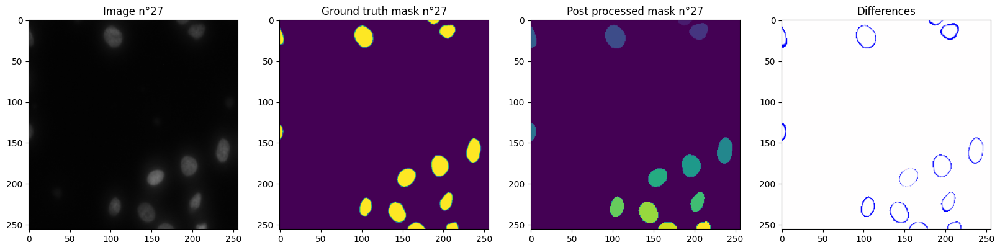

Number of true objects: 5
Number of predicted objects: 5
Thresh	TP	FP	FN	Prec.
0.500	5	0	0	1.000
0.550	4	1	1	0.667
0.600	4	1	1	0.667
0.650	4	1	1	0.667
0.700	4	1	1	0.667
0.750	4	1	1	0.667
0.800	4	1	1	0.667
0.850	3	2	2	0.429
0.900	3	2	2	0.429
0.950	0	5	5	0.000
AP	-	-	-	0.586


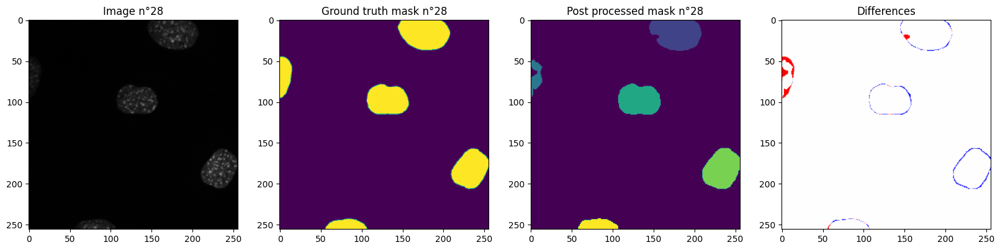

Number of true objects: 8
Number of predicted objects: 7
Thresh	TP	FP	FN	Prec.
0.500	7	0	1	0.875
0.550	7	0	1	0.875
0.600	7	0	1	0.875
0.650	7	0	1	0.875
0.700	7	0	1	0.875
0.750	7	0	1	0.875
0.800	6	1	2	0.667
0.850	4	3	4	0.364
0.900	3	4	5	0.250
0.950	1	6	7	0.071
AP	-	-	-	0.660


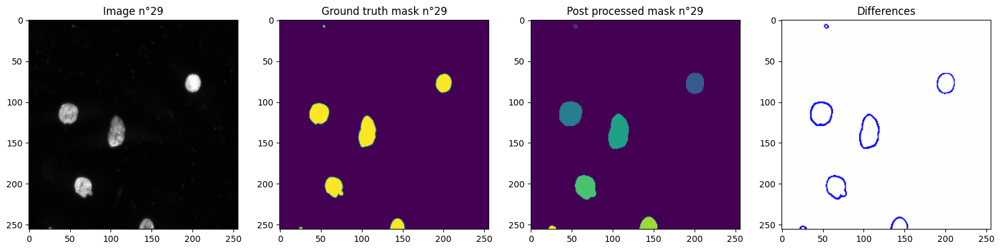

Number of true objects: 8
Number of predicted objects: 9
Thresh	TP	FP	FN	Prec.
0.500	7	2	1	0.700
0.550	7	2	1	0.700
0.600	7	2	1	0.700
0.650	7	2	1	0.700
0.700	7	2	1	0.700
0.750	7	2	1	0.700
0.800	7	2	1	0.700
0.850	5	4	3	0.417
0.900	3	6	5	0.214
0.950	1	8	7	0.062
AP	-	-	-	0.559


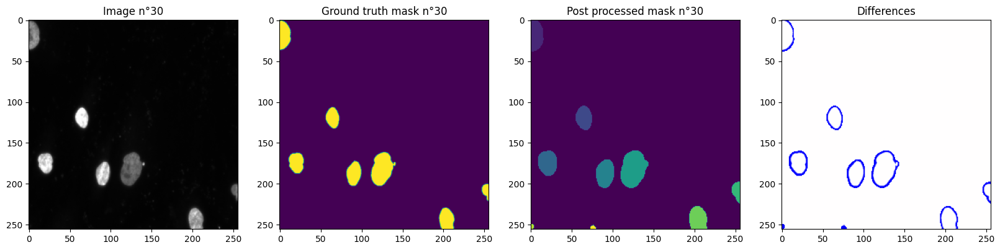

Number of true objects: 21
Number of predicted objects: 19
Thresh	TP	FP	FN	Prec.
0.500	18	1	3	0.818
0.550	18	1	3	0.818
0.600	18	1	3	0.818
0.650	17	2	4	0.739
0.700	17	2	4	0.739
0.750	17	2	4	0.739
0.800	17	2	4	0.739
0.850	15	4	6	0.600
0.900	13	6	8	0.481
0.950	6	13	15	0.176
AP	-	-	-	0.667


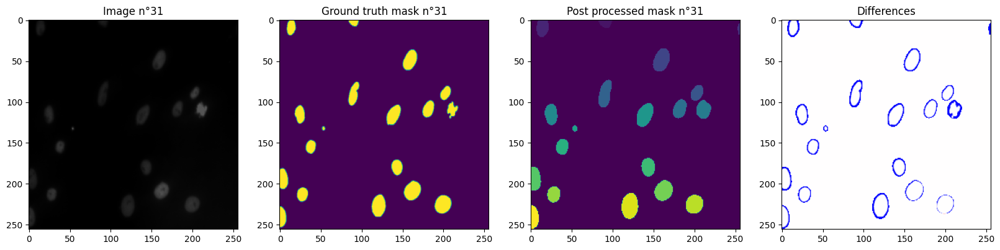

Number of true objects: 4
Number of predicted objects: 3
Thresh	TP	FP	FN	Prec.
0.500	3	0	1	0.750
0.550	3	0	1	0.750
0.600	3	0	1	0.750
0.650	3	0	1	0.750
0.700	3	0	1	0.750
0.750	3	0	1	0.750
0.800	3	0	1	0.750
0.850	3	0	1	0.750
0.900	2	1	2	0.400
0.950	0	3	4	0.000
AP	-	-	-	0.640


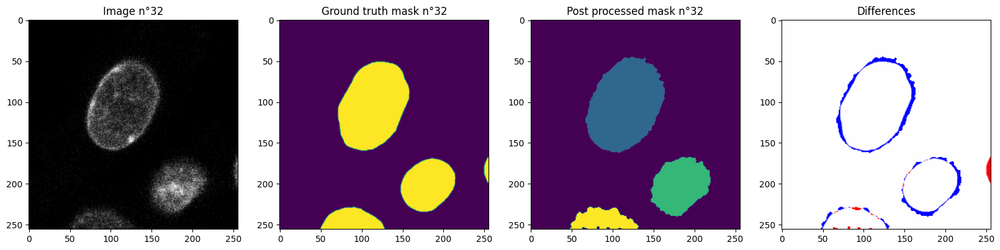

Number of true objects: 90
Number of predicted objects: 67
Thresh	TP	FP	FN	Prec.
0.500	58	9	32	0.586
0.550	55	12	35	0.539
0.600	51	16	39	0.481
0.650	48	19	42	0.440
0.700	46	21	44	0.414
0.750	43	24	47	0.377
0.800	40	27	50	0.342
0.850	32	35	58	0.256
0.900	22	45	68	0.163
0.950	2	65	88	0.013
AP	-	-	-	0.361


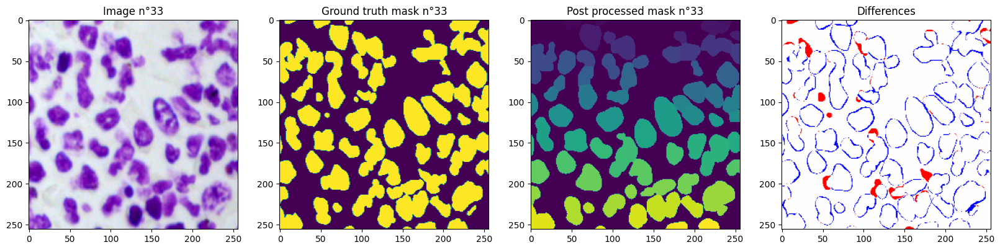

Number of true objects: 57
Number of predicted objects: 56
Thresh	TP	FP	FN	Prec.
0.500	39	17	18	0.527
0.550	38	18	19	0.507
0.600	31	25	26	0.378
0.650	28	28	29	0.329
0.700	26	30	31	0.299
0.750	24	32	33	0.270
0.800	23	33	34	0.256
0.850	18	38	39	0.189
0.900	9	47	48	0.087
0.950	2	54	55	0.018
AP	-	-	-	0.286


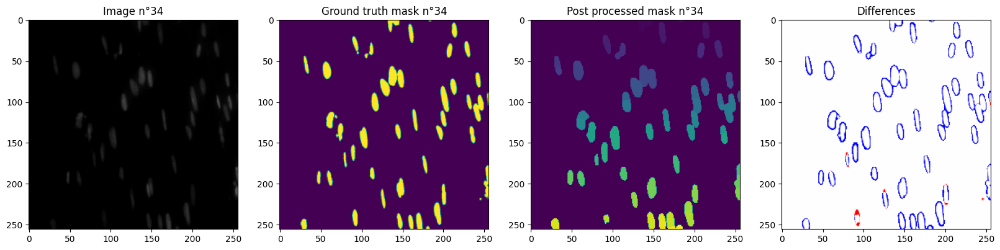

Number of true objects: 13
Number of predicted objects: 14
Thresh	TP	FP	FN	Prec.
0.500	7	7	6	0.350
0.550	5	9	8	0.227
0.600	5	9	8	0.227
0.650	4	10	9	0.174
0.700	3	11	10	0.125
0.750	3	11	10	0.125
0.800	2	12	11	0.080
0.850	1	13	12	0.038
0.900	1	13	12	0.038
0.950	0	14	13	0.000
AP	-	-	-	0.139


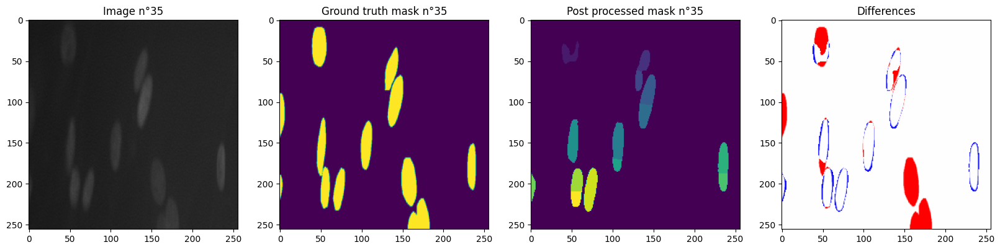

Number of true objects: 28
Number of predicted objects: 20
Thresh	TP	FP	FN	Prec.
0.500	19	1	9	0.655
0.550	18	2	10	0.600
0.600	18	2	10	0.600
0.650	17	3	11	0.548
0.700	17	3	11	0.548
0.750	17	3	11	0.548
0.800	17	3	11	0.548
0.850	16	4	12	0.500
0.900	15	5	13	0.455
0.950	8	12	20	0.200
AP	-	-	-	0.520


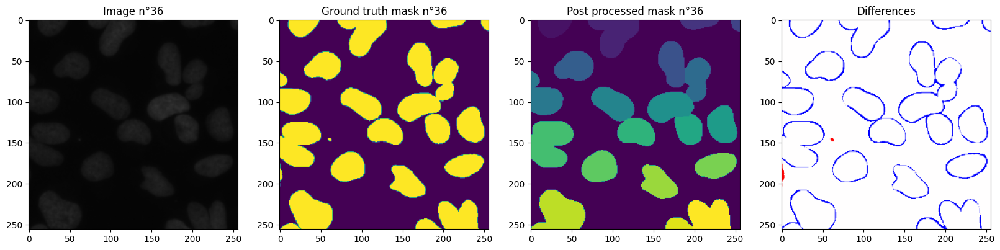

Number of true objects: 12
Number of predicted objects: 11
Thresh	TP	FP	FN	Prec.
0.500	11	0	1	0.917
0.550	11	0	1	0.917
0.600	11	0	1	0.917
0.650	11	0	1	0.917
0.700	11	0	1	0.917
0.750	11	0	1	0.917
0.800	11	0	1	0.917
0.850	9	2	3	0.643
0.900	4	7	8	0.211
0.950	0	11	12	0.000
AP	-	-	-	0.727


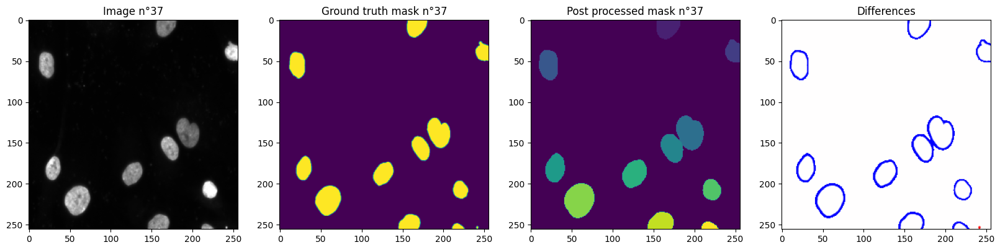

Number of true objects: 25
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	20	1	5	0.769
0.550	19	2	6	0.704
0.600	19	2	6	0.704
0.650	19	2	6	0.704
0.700	19	2	6	0.704
0.750	18	3	7	0.643
0.800	18	3	7	0.643
0.850	17	4	8	0.586
0.900	17	4	8	0.586
0.950	11	10	14	0.314
AP	-	-	-	0.636


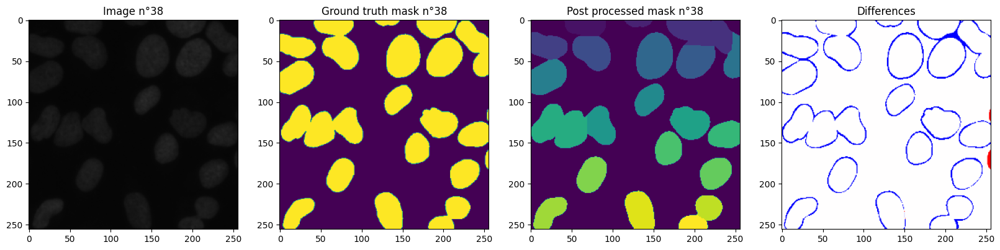

Number of true objects: 1
Number of predicted objects: 1
Thresh	TP	FP	FN	Prec.
0.500	1	0	0	1.000
0.550	1	0	0	1.000
0.600	1	0	0	1.000
0.650	1	0	0	1.000
0.700	1	0	0	1.000
0.750	1	0	0	1.000
0.800	1	0	0	1.000
0.850	1	0	0	1.000
0.900	1	0	0	1.000
0.950	0	1	1	0.000
AP	-	-	-	0.900


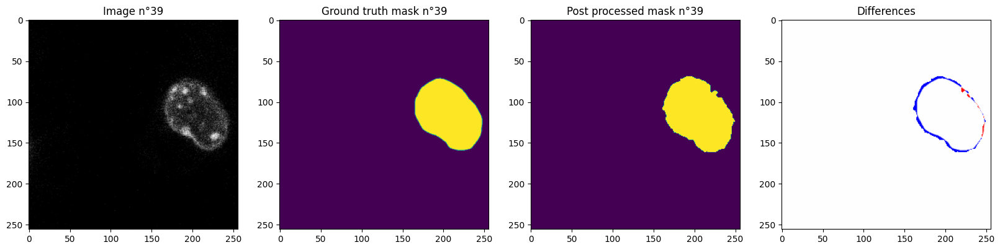

Number of true objects: 18
Number of predicted objects: 18
Thresh	TP	FP	FN	Prec.
0.500	17	1	1	0.895
0.550	17	1	1	0.895
0.600	16	2	2	0.800
0.650	15	3	3	0.714
0.700	15	3	3	0.714
0.750	15	3	3	0.714
0.800	15	3	3	0.714
0.850	13	5	5	0.565
0.900	11	7	7	0.440
0.950	4	14	14	0.125
AP	-	-	-	0.658


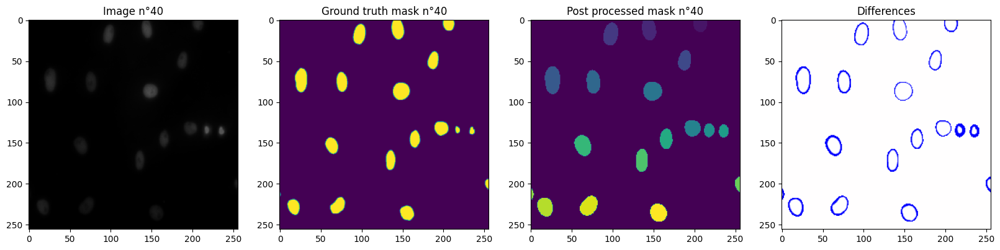

Number of true objects: 17
Number of predicted objects: 13
Thresh	TP	FP	FN	Prec.
0.500	12	1	5	0.667
0.550	12	1	5	0.667
0.600	12	1	5	0.667
0.650	12	1	5	0.667
0.700	12	1	5	0.667
0.750	11	2	6	0.579
0.800	10	3	7	0.500
0.850	7	6	10	0.304
0.900	6	7	11	0.250
0.950	2	11	15	0.071
AP	-	-	-	0.504


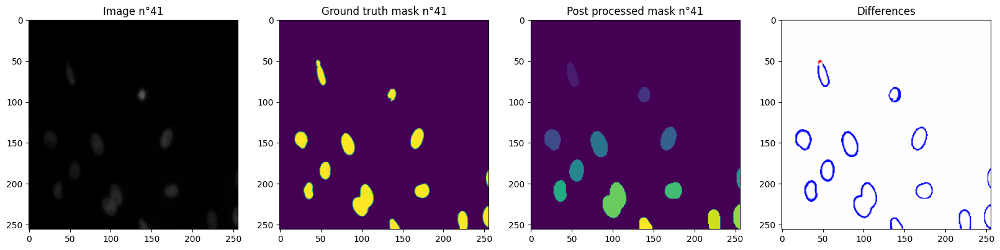

Number of true objects: 72
Number of predicted objects: 53
Thresh	TP	FP	FN	Prec.
0.500	50	3	22	0.667
0.550	49	4	23	0.645
0.600	46	7	26	0.582
0.650	45	8	27	0.562
0.700	41	12	31	0.488
0.750	39	14	33	0.453
0.800	33	20	39	0.359
0.850	27	26	45	0.276
0.900	13	40	59	0.116
0.950	1	52	71	0.008
AP	-	-	-	0.416


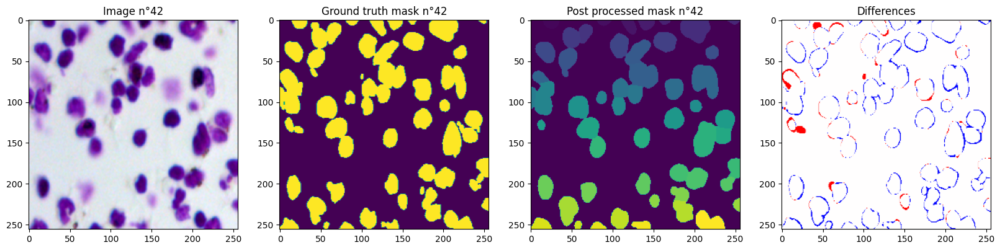

Number of true objects: 16
Number of predicted objects: 16
Thresh	TP	FP	FN	Prec.
0.500	16	0	0	1.000
0.550	16	0	0	1.000
0.600	15	1	1	0.882
0.650	15	1	1	0.882
0.700	15	1	1	0.882
0.750	14	2	2	0.778
0.800	12	4	4	0.600
0.850	11	5	5	0.524
0.900	9	7	7	0.391
0.950	1	15	15	0.032
AP	-	-	-	0.697


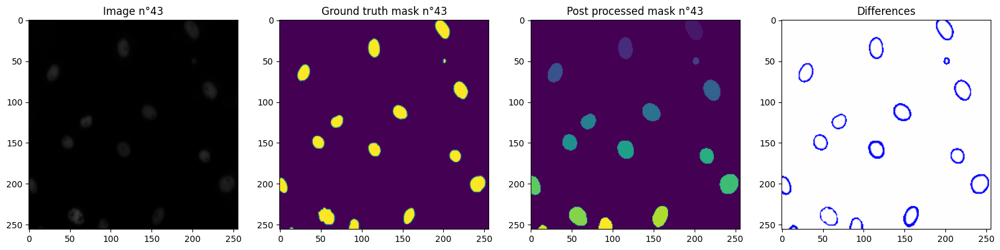

Number of true objects: 10
Number of predicted objects: 10
Thresh	TP	FP	FN	Prec.
0.500	9	1	1	0.818
0.550	9	1	1	0.818
0.600	9	1	1	0.818
0.650	9	1	1	0.818
0.700	9	1	1	0.818
0.750	9	1	1	0.818
0.800	9	1	1	0.818
0.850	9	1	1	0.818
0.900	9	1	1	0.818
0.950	6	4	4	0.429
AP	-	-	-	0.779


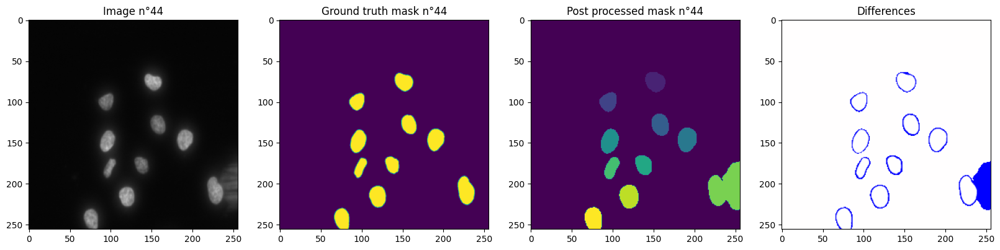

Number of true objects: 10
Number of predicted objects: 9
Thresh	TP	FP	FN	Prec.
0.500	8	1	2	0.727
0.550	8	1	2	0.727
0.600	8	1	2	0.727
0.650	8	1	2	0.727
0.700	8	1	2	0.727
0.750	8	1	2	0.727
0.800	8	1	2	0.727
0.850	6	3	4	0.462
0.900	2	7	8	0.118
0.950	0	9	10	0.000
AP	-	-	-	0.567


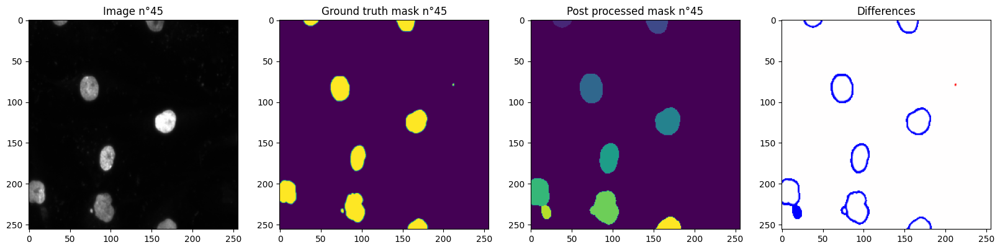

Number of true objects: 53
Number of predicted objects: 44
Thresh	TP	FP	FN	Prec.
0.500	38	6	15	0.644
0.550	34	10	19	0.540
0.600	32	12	21	0.492
0.650	30	14	23	0.448
0.700	29	15	24	0.426
0.750	26	18	27	0.366
0.800	24	20	29	0.329
0.850	18	26	35	0.228
0.900	13	31	40	0.155
0.950	0	44	53	0.000
AP	-	-	-	0.363


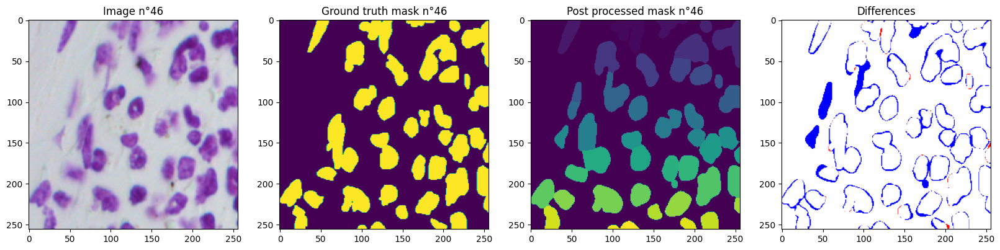

Number of true objects: 64
Number of predicted objects: 42
Thresh	TP	FP	FN	Prec.
0.500	34	8	30	0.472
0.550	34	8	30	0.472
0.600	33	9	31	0.452
0.650	31	11	33	0.413
0.700	30	12	34	0.395
0.750	27	15	37	0.342
0.800	27	15	37	0.342
0.850	23	19	41	0.277
0.900	11	31	53	0.116
0.950	0	42	64	0.000
AP	-	-	-	0.328


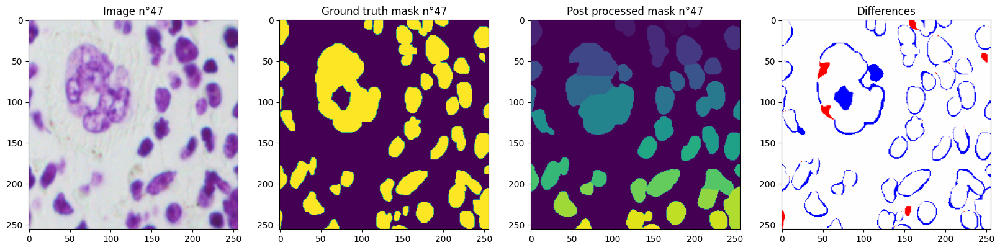

Number of true objects: 27
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	21	0	6	0.778
0.550	21	0	6	0.778
0.600	21	0	6	0.778
0.650	21	0	6	0.778
0.700	21	0	6	0.778
0.750	20	1	7	0.714
0.800	20	1	7	0.714
0.850	18	3	9	0.600
0.900	15	6	12	0.455
0.950	10	11	17	0.263
AP	-	-	-	0.664


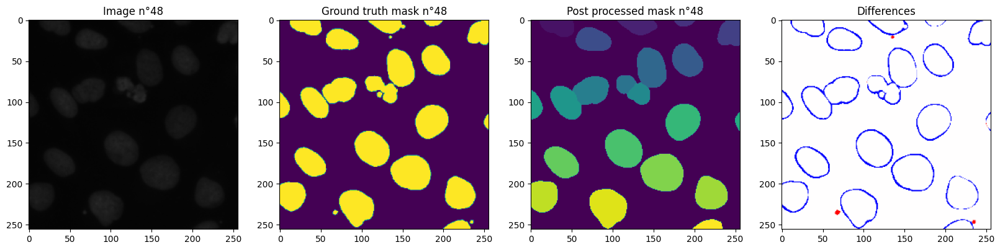

Number of true objects: 36
Number of predicted objects: 42
Thresh	TP	FP	FN	Prec.
0.500	32	10	4	0.696
0.550	30	12	6	0.625
0.600	30	12	6	0.625
0.650	25	17	11	0.472
0.700	22	20	14	0.393
0.750	22	20	14	0.393
0.800	21	21	15	0.368
0.850	21	21	15	0.368
0.900	15	27	21	0.238
0.950	5	37	31	0.068
AP	-	-	-	0.425


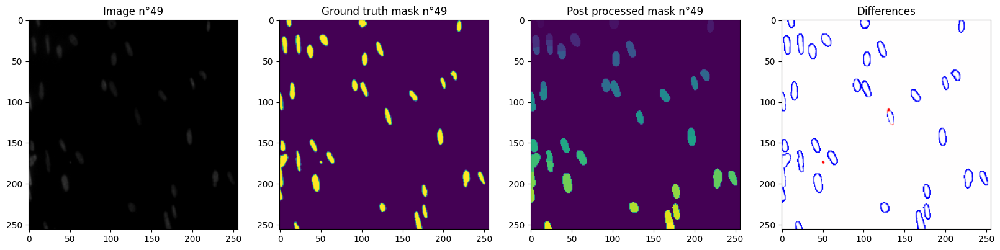

Number of true objects: 2
Number of predicted objects: 5
Thresh	TP	FP	FN	Prec.
0.500	2	3	0	0.400
0.550	2	3	0	0.400
0.600	2	3	0	0.400
0.650	2	3	0	0.400
0.700	2	3	0	0.400
0.750	2	3	0	0.400
0.800	1	4	1	0.167
0.850	0	5	2	0.000
0.900	0	5	2	0.000
0.950	0	5	2	0.000
AP	-	-	-	0.257


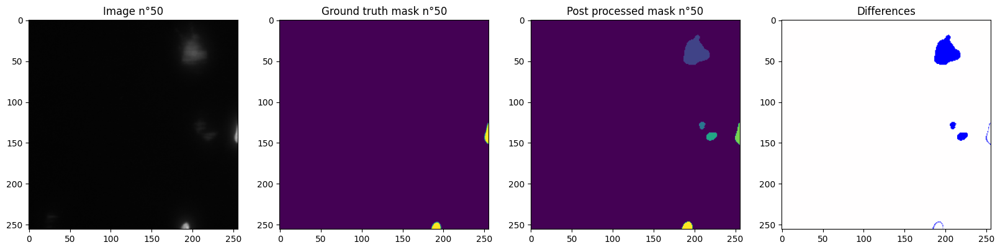

Number of true objects: 25
Number of predicted objects: 17
Thresh	TP	FP	FN	Prec.
0.500	11	6	14	0.355
0.550	11	6	14	0.355
0.600	10	7	15	0.312
0.650	9	8	16	0.273
0.700	7	10	18	0.200
0.750	7	10	18	0.200
0.800	5	12	20	0.135
0.850	2	15	23	0.050
0.900	1	16	24	0.024
0.950	0	17	25	0.000
AP	-	-	-	0.190


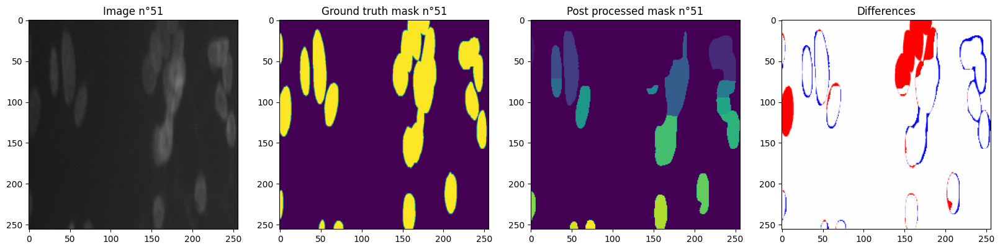

Number of true objects: 25
Number of predicted objects: 19
Thresh	TP	FP	FN	Prec.
0.500	16	3	9	0.571
0.550	15	4	10	0.517
0.600	15	4	10	0.517
0.650	15	4	10	0.517
0.700	15	4	10	0.517
0.750	15	4	10	0.517
0.800	15	4	10	0.517
0.850	15	4	10	0.517
0.900	15	4	10	0.517
0.950	7	12	18	0.189
AP	-	-	-	0.490


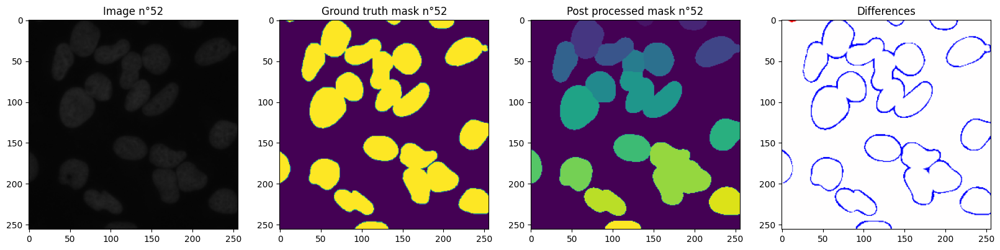

Number of true objects: 15
Number of predicted objects: 13
Thresh	TP	FP	FN	Prec.
0.500	13	0	2	0.867
0.550	12	1	3	0.750
0.600	12	1	3	0.750
0.650	12	1	3	0.750
0.700	11	2	4	0.647
0.750	11	2	4	0.647
0.800	11	2	4	0.647
0.850	10	3	5	0.556
0.900	8	5	7	0.400
0.950	3	10	12	0.120
AP	-	-	-	0.613


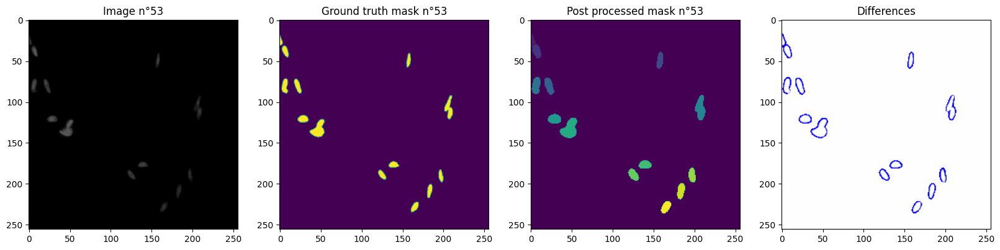

Number of true objects: 79
Number of predicted objects: 53
Thresh	TP	FP	FN	Prec.
0.500	46	7	33	0.535
0.550	44	9	35	0.500
0.600	44	9	35	0.500
0.650	40	13	39	0.435
0.700	40	13	39	0.435
0.750	36	17	43	0.375
0.800	33	20	46	0.333
0.850	26	27	53	0.245
0.900	12	41	67	0.100
0.950	1	52	78	0.008
AP	-	-	-	0.347


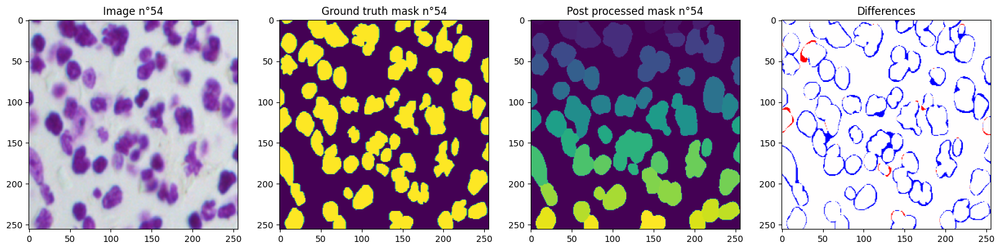

Number of true objects: 158
Number of predicted objects: 84
Thresh	TP	FP	FN	Prec.
0.500	51	33	107	0.267
0.550	46	38	112	0.235
0.600	39	45	119	0.192
0.650	31	53	127	0.147
0.700	27	57	131	0.126
0.750	22	62	136	0.100
0.800	15	69	143	0.066
0.850	8	76	150	0.034
0.900	1	83	157	0.004
0.950	0	84	158	0.000
AP	-	-	-	0.117


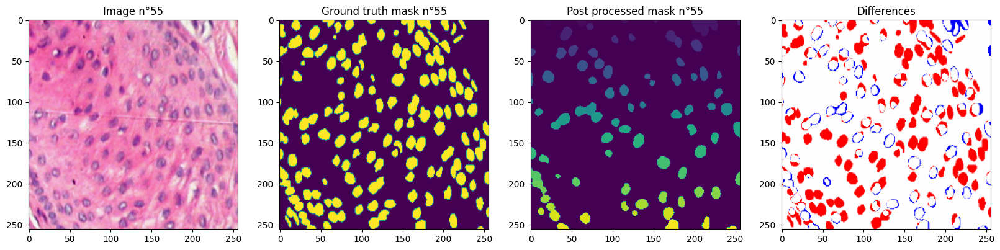

Number of true objects: 31
Number of predicted objects: 31
Thresh	TP	FP	FN	Prec.
0.500	27	4	4	0.771
0.550	27	4	4	0.771
0.600	27	4	4	0.771
0.650	27	4	4	0.771
0.700	26	5	5	0.722
0.750	22	9	9	0.550
0.800	17	14	14	0.378
0.850	10	21	21	0.192
0.900	2	29	29	0.033
0.950	1	30	30	0.016
AP	-	-	-	0.498


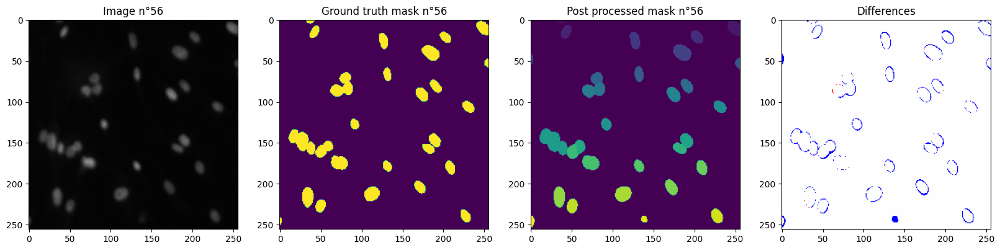

Number of true objects: 100
Number of predicted objects: 62
Thresh	TP	FP	FN	Prec.
0.500	52	10	48	0.473
0.550	49	13	51	0.434
0.600	44	18	56	0.373
0.650	42	20	58	0.350
0.700	41	21	59	0.339
0.750	38	24	62	0.306
0.800	35	27	65	0.276
0.850	32	30	68	0.246
0.900	17	45	83	0.117
0.950	0	62	100	0.000
AP	-	-	-	0.291


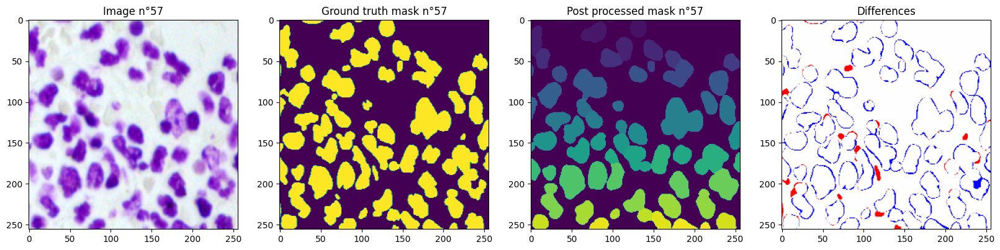

Number of true objects: 19
Number of predicted objects: 17
Thresh	TP	FP	FN	Prec.
0.500	17	0	2	0.895
0.550	17	0	2	0.895
0.600	17	0	2	0.895
0.650	17	0	2	0.895
0.700	17	0	2	0.895
0.750	17	0	2	0.895
0.800	17	0	2	0.895
0.850	15	2	4	0.714
0.900	15	2	4	0.714
0.950	6	11	13	0.200
AP	-	-	-	0.789


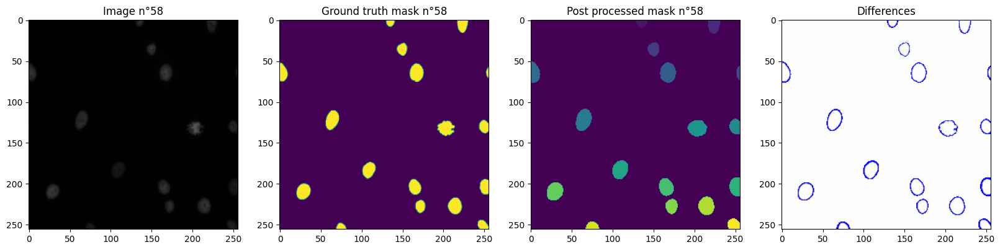

Number of true objects: 14
Number of predicted objects: 20
Thresh	TP	FP	FN	Prec.
0.500	7	13	7	0.259
0.550	6	14	8	0.214
0.600	5	15	9	0.172
0.650	4	16	10	0.133
0.700	4	16	10	0.133
0.750	4	16	10	0.133
0.800	4	16	10	0.133
0.850	2	18	12	0.062
0.900	1	19	13	0.030
0.950	0	20	14	0.000
AP	-	-	-	0.127


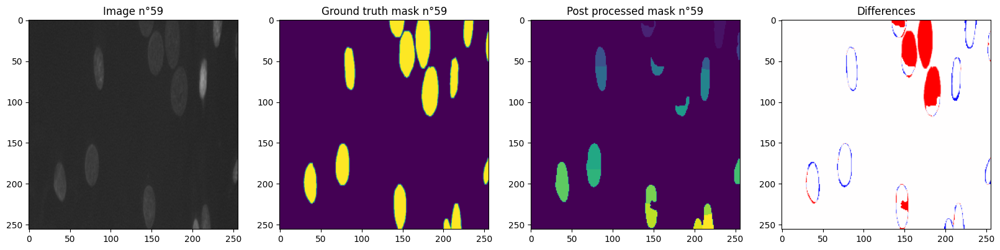

Number of true objects: 12
Number of predicted objects: 17
Thresh	TP	FP	FN	Prec.
0.500	12	5	0	0.706
0.550	12	5	0	0.706
0.600	12	5	0	0.706
0.650	12	5	0	0.706
0.700	10	7	2	0.526
0.750	9	8	3	0.450
0.800	8	9	4	0.381
0.850	3	14	9	0.115
0.900	1	16	11	0.036
0.950	0	17	12	0.000
AP	-	-	-	0.433


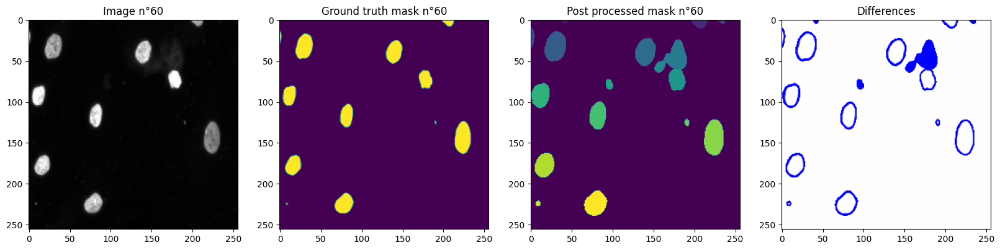

Number of true objects: 8
Number of predicted objects: 8
Thresh	TP	FP	FN	Prec.
0.500	8	0	0	1.000
0.550	8	0	0	1.000
0.600	8	0	0	1.000
0.650	8	0	0	1.000
0.700	8	0	0	1.000
0.750	8	0	0	1.000
0.800	8	0	0	1.000
0.850	6	2	2	0.600
0.900	5	3	3	0.455
0.950	2	6	6	0.143
AP	-	-	-	0.820


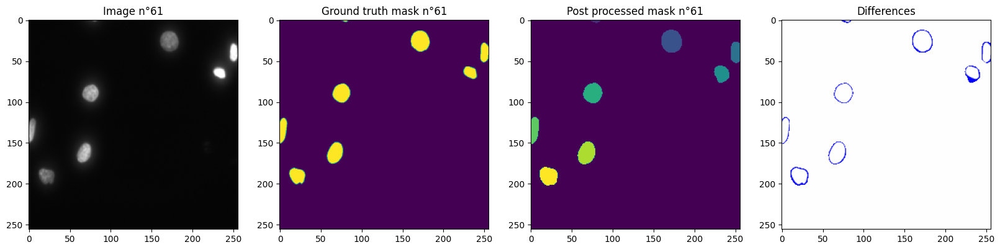

Number of true objects: 20
Number of predicted objects: 18
Thresh	TP	FP	FN	Prec.
0.500	18	0	2	0.900
0.550	18	0	2	0.900
0.600	18	0	2	0.900
0.650	18	0	2	0.900
0.700	18	0	2	0.900
0.750	18	0	2	0.900
0.800	18	0	2	0.900
0.850	18	0	2	0.900
0.900	17	1	3	0.810
0.950	7	11	13	0.226
AP	-	-	-	0.824


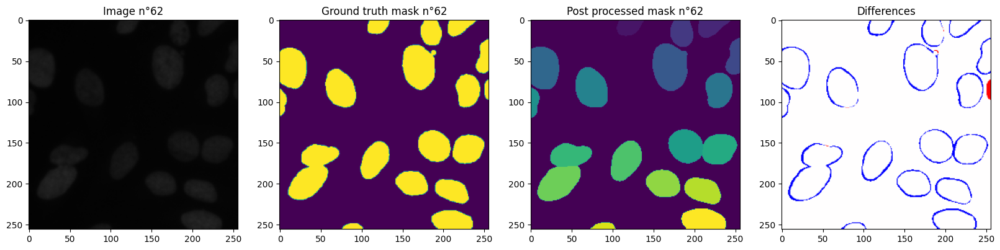

Number of true objects: 16
Number of predicted objects: 34
Thresh	TP	FP	FN	Prec.
0.500	5	29	11	0.111
0.550	3	31	13	0.064
0.600	3	31	13	0.064
0.650	3	31	13	0.064
0.700	3	31	13	0.064
0.750	2	32	14	0.042
0.800	1	33	15	0.020
0.850	1	33	15	0.020
0.900	0	34	16	0.000
0.950	0	34	16	0.000
AP	-	-	-	0.045


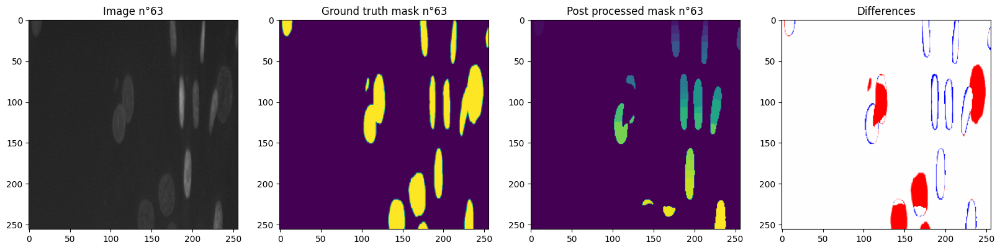

Number of true objects: 22
Number of predicted objects: 18
Thresh	TP	FP	FN	Prec.
0.500	18	0	4	0.818
0.550	18	0	4	0.818
0.600	18	0	4	0.818
0.650	18	0	4	0.818
0.700	17	1	5	0.739
0.750	16	2	6	0.667
0.800	16	2	6	0.667
0.850	14	4	8	0.538
0.900	13	5	9	0.481
0.950	6	12	16	0.176
AP	-	-	-	0.654


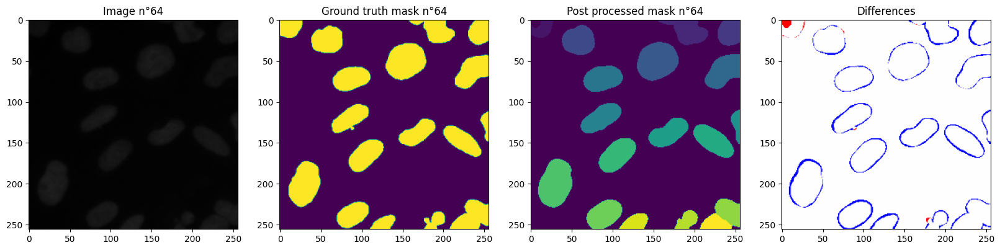

Number of true objects: 1
Number of predicted objects: 1
Thresh	TP	FP	FN	Prec.
0.500	1	0	0	1.000
0.550	1	0	0	1.000
0.600	1	0	0	1.000
0.650	1	0	0	1.000
0.700	1	0	0	1.000
0.750	1	0	0	1.000
0.800	1	0	0	1.000
0.850	1	0	0	1.000
0.900	1	0	0	1.000
0.950	0	1	1	0.000
AP	-	-	-	0.900


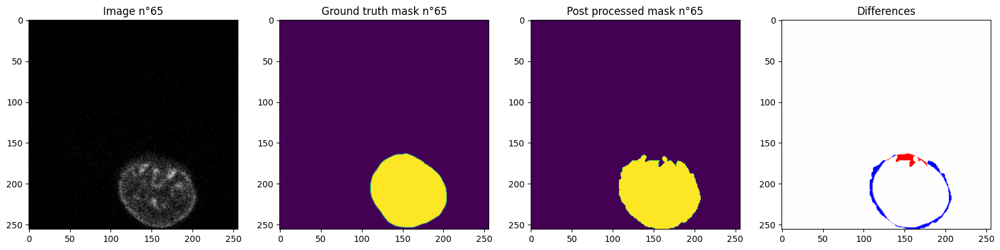

Number of true objects: 28
Number of predicted objects: 27
Thresh	TP	FP	FN	Prec.
0.500	27	0	1	0.964
0.550	27	0	1	0.964
0.600	27	0	1	0.964
0.650	27	0	1	0.964
0.700	26	1	2	0.897
0.750	25	2	3	0.833
0.800	24	3	4	0.774
0.850	22	5	6	0.667
0.900	18	9	10	0.486
0.950	8	19	20	0.170
AP	-	-	-	0.768


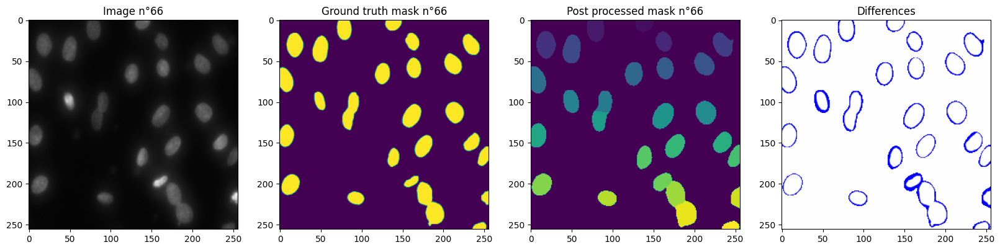

Number of true objects: 50
Number of predicted objects: 44
Thresh	TP	FP	FN	Prec.
0.500	37	7	13	0.649
0.550	36	8	14	0.621
0.600	34	10	16	0.567
0.650	32	12	18	0.516
0.700	28	16	22	0.424
0.750	28	16	22	0.424
0.800	28	16	22	0.424
0.850	25	19	25	0.362
0.900	14	30	36	0.175
0.950	1	43	49	0.011
AP	-	-	-	0.417


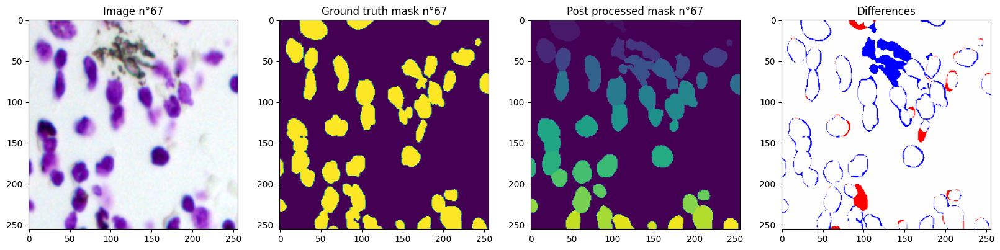

Number of true objects: 5
Number of predicted objects: 3
Thresh	TP	FP	FN	Prec.
0.500	3	0	2	0.600
0.550	3	0	2	0.600
0.600	3	0	2	0.600
0.650	3	0	2	0.600
0.700	3	0	2	0.600
0.750	3	0	2	0.600
0.800	2	1	3	0.333
0.850	2	1	3	0.333
0.900	2	1	3	0.333
0.950	0	3	5	0.000
AP	-	-	-	0.460


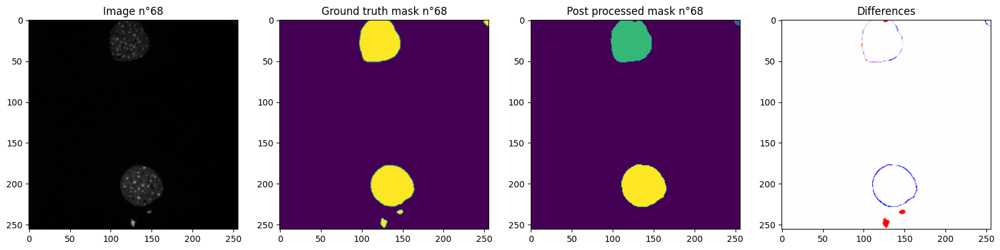

Number of true objects: 11
Number of predicted objects: 8
Thresh	TP	FP	FN	Prec.
0.500	8	0	3	0.727
0.550	8	0	3	0.727
0.600	7	1	4	0.583
0.650	7	1	4	0.583
0.700	7	1	4	0.583
0.750	7	1	4	0.583
0.800	7	1	4	0.583
0.850	7	1	4	0.583
0.900	6	2	5	0.462
0.950	1	7	10	0.056
AP	-	-	-	0.547


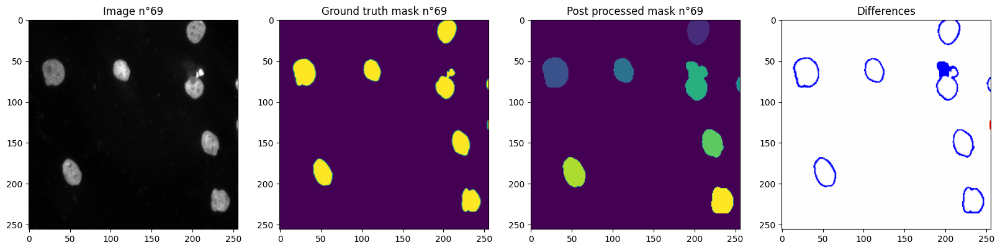

Number of true objects: 40
Number of predicted objects: 44
Thresh	TP	FP	FN	Prec.
0.500	40	4	0	0.909
0.550	40	4	0	0.909
0.600	40	4	0	0.909
0.650	40	4	0	0.909
0.700	39	5	1	0.867
0.750	34	10	6	0.680
0.800	27	17	13	0.474
0.850	10	34	30	0.135
0.900	2	42	38	0.024
0.950	1	43	39	0.012
AP	-	-	-	0.583


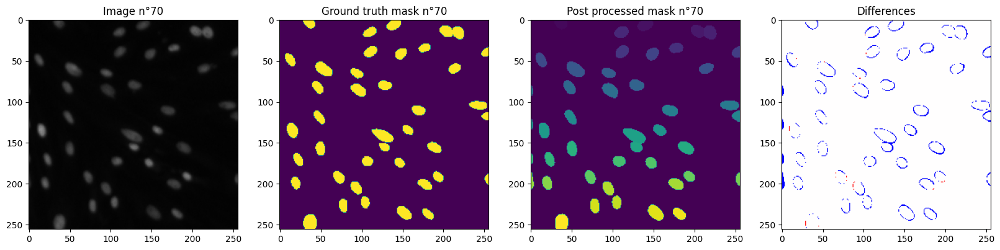

Number of true objects: 4
Number of predicted objects: 7
Thresh	TP	FP	FN	Prec.
0.500	2	5	2	0.222
0.550	2	5	2	0.222
0.600	2	5	2	0.222
0.650	2	5	2	0.222
0.700	2	5	2	0.222
0.750	2	5	2	0.222
0.800	2	5	2	0.222
0.850	2	5	2	0.222
0.900	0	7	4	0.000
0.950	0	7	4	0.000
AP	-	-	-	0.178


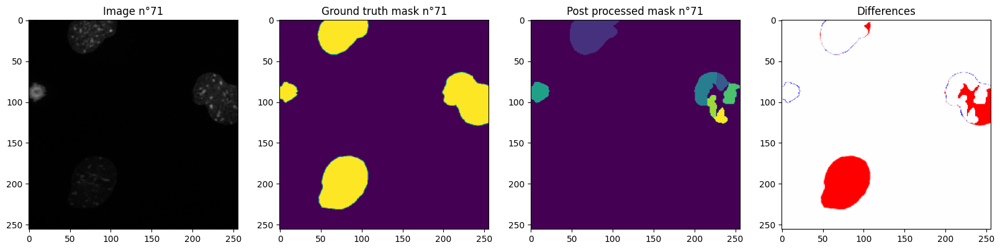

Number of true objects: 14
Number of predicted objects: 14
Thresh	TP	FP	FN	Prec.
0.500	12	2	2	0.750
0.550	10	4	4	0.556
0.600	10	4	4	0.556
0.650	10	4	4	0.556
0.700	10	4	4	0.556
0.750	10	4	4	0.556
0.800	10	4	4	0.556
0.850	10	4	4	0.556
0.900	9	5	5	0.474
0.950	4	10	10	0.167
AP	-	-	-	0.528


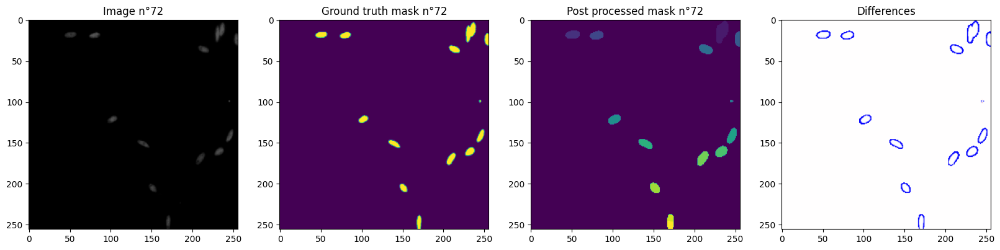

Number of true objects: 30
Number of predicted objects: 25
Thresh	TP	FP	FN	Prec.
0.500	25	0	5	0.833
0.550	25	0	5	0.833
0.600	25	0	5	0.833
0.650	25	0	5	0.833
0.700	25	0	5	0.833
0.750	25	0	5	0.833
0.800	25	0	5	0.833
0.850	24	1	6	0.774
0.900	22	3	8	0.667
0.950	9	16	21	0.196
AP	-	-	-	0.747


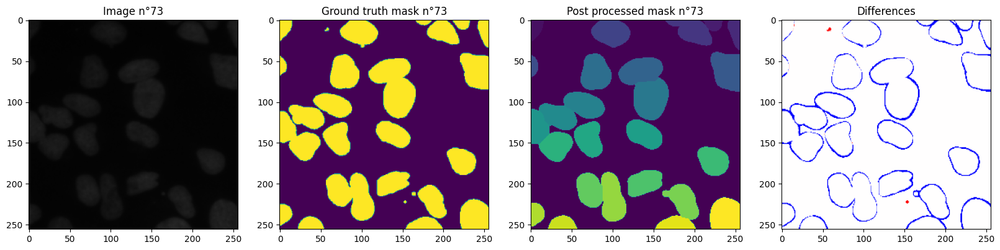

Number of true objects: 78
Number of predicted objects: 58
Thresh	TP	FP	FN	Prec.
0.500	49	9	29	0.563
0.550	48	10	30	0.545
0.600	45	13	33	0.495
0.650	41	17	37	0.432
0.700	41	17	37	0.432
0.750	37	21	41	0.374
0.800	31	27	47	0.295
0.850	22	36	56	0.193
0.900	8	50	70	0.062
0.950	0	58	78	0.000
AP	-	-	-	0.339


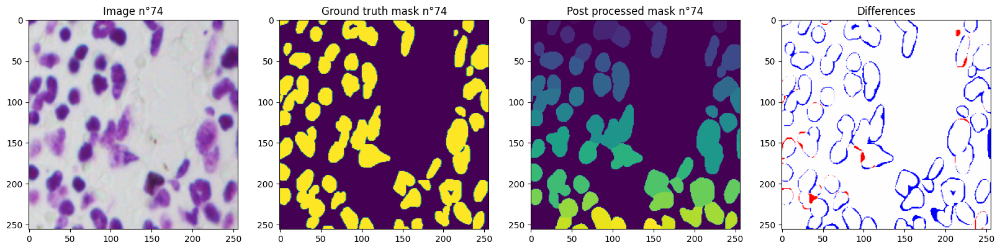

Number of true objects: 54
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	15	6	39	0.250
0.550	14	7	40	0.230
0.600	14	7	40	0.230
0.650	13	8	41	0.210
0.700	13	8	41	0.210
0.750	12	9	42	0.190
0.800	12	9	42	0.190
0.850	7	14	47	0.103
0.900	0	21	54	0.000
0.950	0	21	54	0.000
AP	-	-	-	0.161


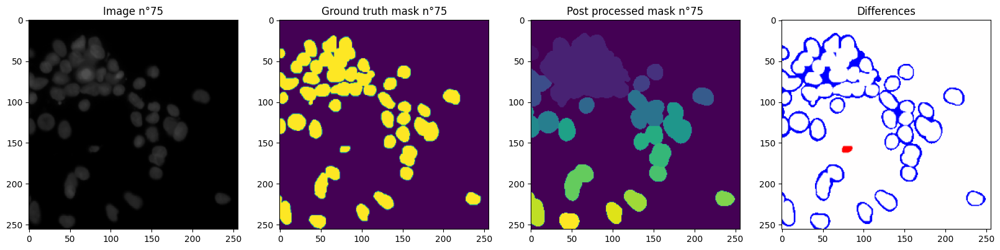

Number of true objects: 34
Number of predicted objects: 34
Thresh	TP	FP	FN	Prec.
0.500	33	1	1	0.943
0.550	32	2	2	0.889
0.600	30	4	4	0.789
0.650	29	5	5	0.744
0.700	26	8	8	0.619
0.750	13	21	21	0.236
0.800	9	25	25	0.153
0.850	0	34	34	0.000
0.900	0	34	34	0.000
0.950	0	34	34	0.000
AP	-	-	-	0.437


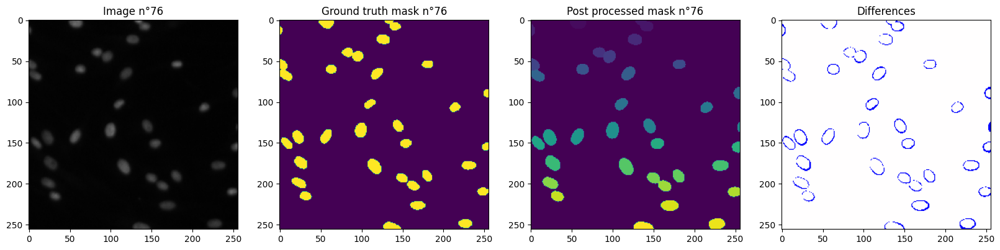

Number of true objects: 32
Number of predicted objects: 27
Thresh	TP	FP	FN	Prec.
0.500	24	3	8	0.686
0.550	21	6	11	0.553
0.600	21	6	11	0.553
0.650	21	6	11	0.553
0.700	21	6	11	0.553
0.750	21	6	11	0.553
0.800	19	8	13	0.475
0.850	17	10	15	0.405
0.900	10	17	22	0.204
0.950	2	25	30	0.035
AP	-	-	-	0.457


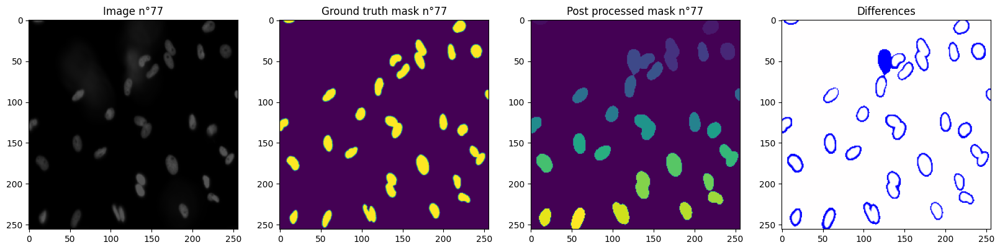

Number of true objects: 29
Number of predicted objects: 23
Thresh	TP	FP	FN	Prec.
0.500	22	1	7	0.733
0.550	21	2	8	0.677
0.600	21	2	8	0.677
0.650	21	2	8	0.677
0.700	21	2	8	0.677
0.750	21	2	8	0.677
0.800	21	2	8	0.677
0.850	19	4	10	0.576
0.900	14	9	15	0.368
0.950	9	14	20	0.209
AP	-	-	-	0.595


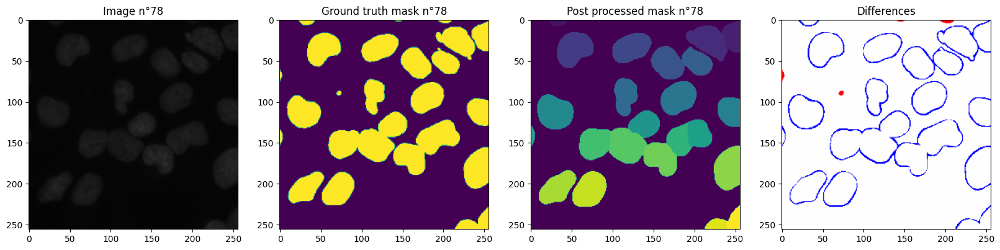

Number of true objects: 10
Number of predicted objects: 8
Thresh	TP	FP	FN	Prec.
0.500	8	0	2	0.800
0.550	8	0	2	0.800
0.600	7	1	3	0.636
0.650	7	1	3	0.636
0.700	7	1	3	0.636
0.750	6	2	4	0.500
0.800	6	2	4	0.500
0.850	6	2	4	0.500
0.900	3	5	7	0.200
0.950	1	7	9	0.059
AP	-	-	-	0.527


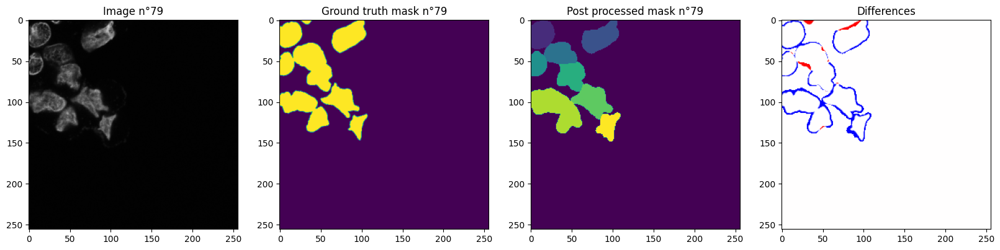

Number of true objects: 3
Number of predicted objects: 4
Thresh	TP	FP	FN	Prec.
0.500	3	1	0	0.750
0.550	3	1	0	0.750
0.600	3	1	0	0.750
0.650	3	1	0	0.750
0.700	3	1	0	0.750
0.750	3	1	0	0.750
0.800	3	1	0	0.750
0.850	3	1	0	0.750
0.900	3	1	0	0.750
0.950	2	2	1	0.400
AP	-	-	-	0.715


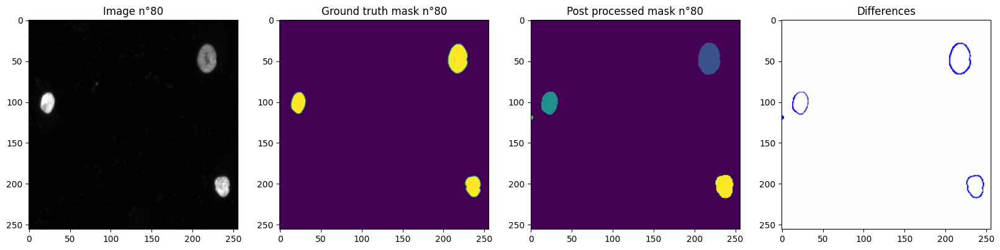

Number of true objects: 5
Number of predicted objects: 6
Thresh	TP	FP	FN	Prec.
0.500	4	2	1	0.571
0.550	4	2	1	0.571
0.600	4	2	1	0.571
0.650	4	2	1	0.571
0.700	4	2	1	0.571
0.750	4	2	1	0.571
0.800	4	2	1	0.571
0.850	3	3	2	0.375
0.900	3	3	2	0.375
0.950	2	4	3	0.222
AP	-	-	-	0.497


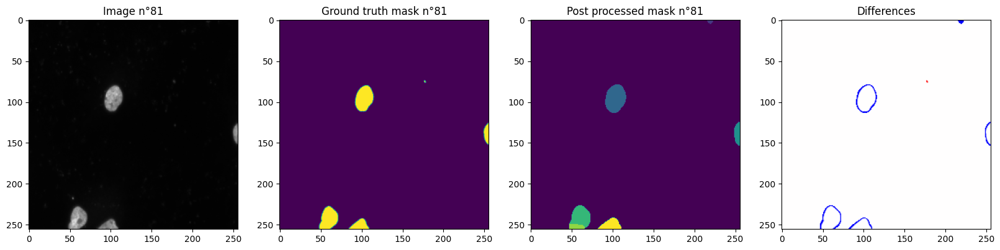

Number of true objects: 22
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	20	1	2	0.870
0.550	20	1	2	0.870
0.600	20	1	2	0.870
0.650	19	2	3	0.792
0.700	19	2	3	0.792
0.750	19	2	3	0.792
0.800	18	3	4	0.720
0.850	17	4	5	0.654
0.900	16	5	6	0.593
0.950	7	14	15	0.194
AP	-	-	-	0.714


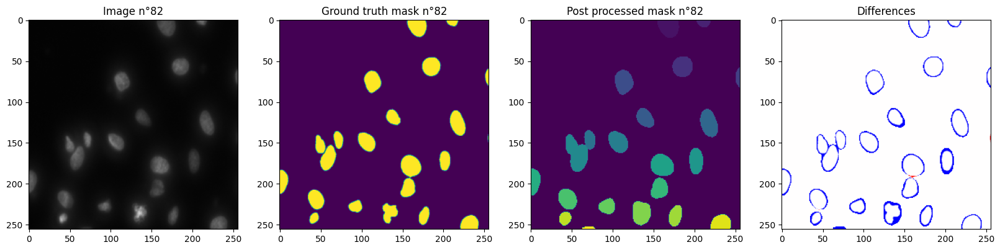

Number of true objects: 4
Number of predicted objects: 5
Thresh	TP	FP	FN	Prec.
0.500	4	1	0	0.800
0.550	4	1	0	0.800
0.600	4	1	0	0.800
0.650	4	1	0	0.800
0.700	4	1	0	0.800
0.750	4	1	0	0.800
0.800	4	1	0	0.800
0.850	4	1	0	0.800
0.900	3	2	1	0.500
0.950	1	4	3	0.125
AP	-	-	-	0.703


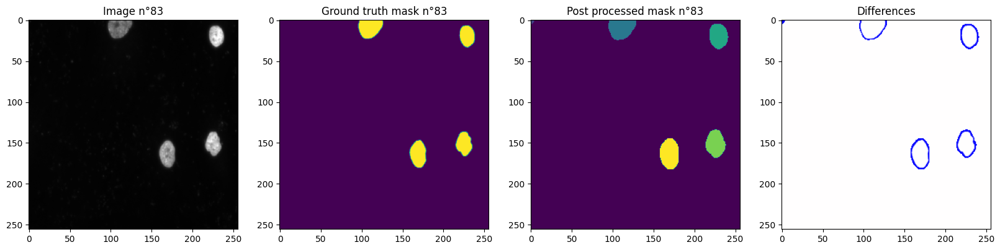

Number of true objects: 24
Number of predicted objects: 20
Thresh	TP	FP	FN	Prec.
0.500	20	0	4	0.833
0.550	20	0	4	0.833
0.600	20	0	4	0.833
0.650	20	0	4	0.833
0.700	20	0	4	0.833
0.750	19	1	5	0.760
0.800	18	2	6	0.692
0.850	18	2	6	0.692
0.900	16	4	8	0.571
0.950	11	9	13	0.333
AP	-	-	-	0.722


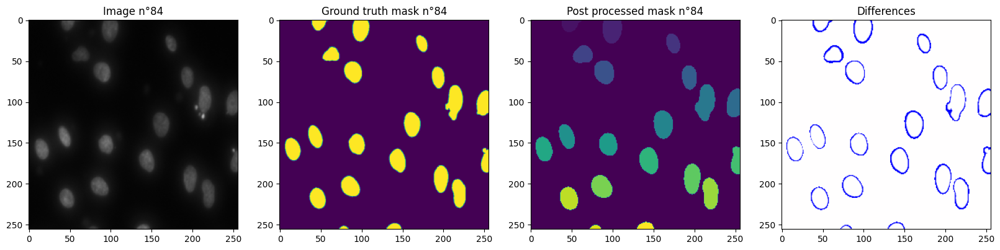

Number of true objects: 3
Number of predicted objects: 2
Thresh	TP	FP	FN	Prec.
0.500	2	0	1	0.667
0.550	2	0	1	0.667
0.600	2	0	1	0.667
0.650	2	0	1	0.667
0.700	2	0	1	0.667
0.750	2	0	1	0.667
0.800	2	0	1	0.667
0.850	2	0	1	0.667
0.900	0	2	3	0.000
0.950	0	2	3	0.000
AP	-	-	-	0.533


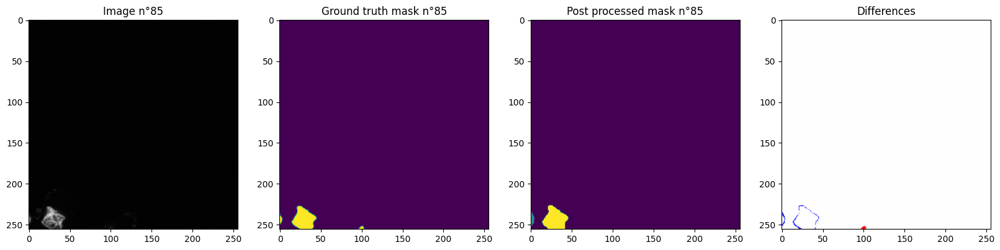

Number of true objects: 4
Number of predicted objects: 5
Thresh	TP	FP	FN	Prec.
0.500	4	1	0	0.800
0.550	4	1	0	0.800
0.600	3	2	1	0.500
0.650	3	2	1	0.500
0.700	3	2	1	0.500
0.750	3	2	1	0.500
0.800	2	3	2	0.286
0.850	2	3	2	0.286
0.900	1	4	3	0.125
0.950	0	5	4	0.000
AP	-	-	-	0.430


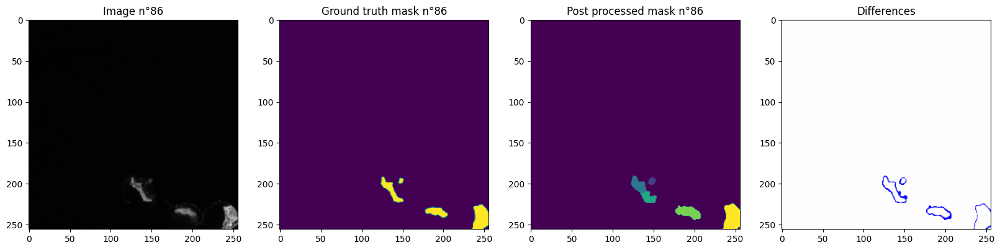

Number of true objects: 26
Number of predicted objects: 23
Thresh	TP	FP	FN	Prec.
0.500	20	3	6	0.690
0.550	18	5	8	0.581
0.600	17	6	9	0.531
0.650	17	6	9	0.531
0.700	17	6	9	0.531
0.750	17	6	9	0.531
0.800	15	8	11	0.441
0.850	6	17	20	0.140
0.900	2	21	24	0.043
0.950	0	23	26	0.000
AP	-	-	-	0.402


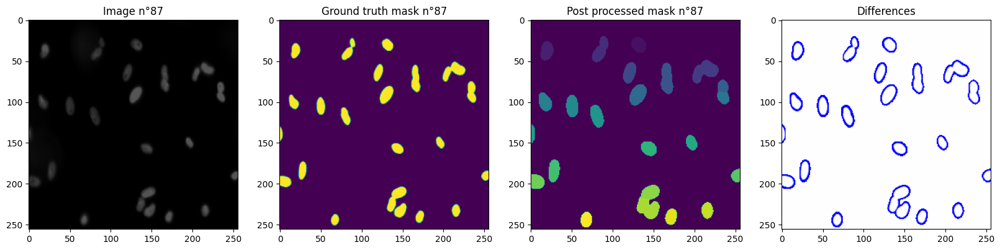

Number of true objects: 94
Number of predicted objects: 62
Thresh	TP	FP	FN	Prec.
0.500	56	6	38	0.560
0.550	51	11	43	0.486
0.600	45	17	49	0.405
0.650	45	17	49	0.405
0.700	43	19	51	0.381
0.750	40	22	54	0.345
0.800	35	27	59	0.289
0.850	27	35	67	0.209
0.900	8	54	86	0.054
0.950	0	62	94	0.000
AP	-	-	-	0.313


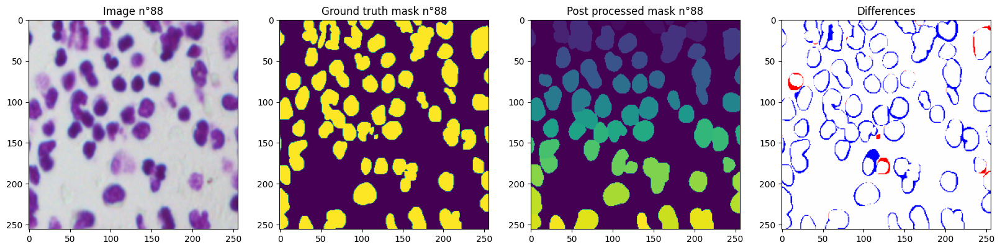

Number of true objects: 4
Number of predicted objects: 3
Thresh	TP	FP	FN	Prec.
0.500	3	0	1	0.750
0.550	3	0	1	0.750
0.600	2	1	2	0.400
0.650	2	1	2	0.400
0.700	2	1	2	0.400
0.750	2	1	2	0.400
0.800	2	1	2	0.400
0.850	2	1	2	0.400
0.900	1	2	3	0.167
0.950	0	3	4	0.000
AP	-	-	-	0.407


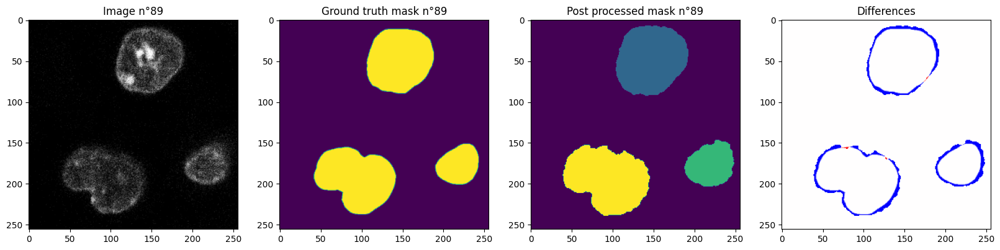

Number of true objects: 40
Number of predicted objects: 34
Thresh	TP	FP	FN	Prec.
0.500	31	3	9	0.721
0.550	29	5	11	0.644
0.600	29	5	11	0.644
0.650	28	6	12	0.609
0.700	28	6	12	0.609
0.750	28	6	12	0.609
0.800	26	8	14	0.542
0.850	24	10	16	0.480
0.900	15	19	25	0.254
0.950	6	28	34	0.088
AP	-	-	-	0.520


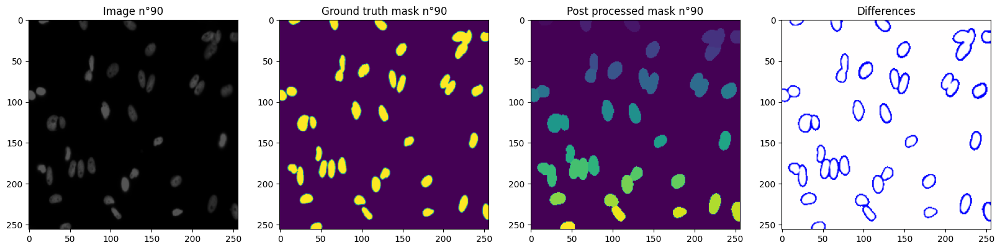

Number of true objects: 164
Number of predicted objects: 105
Thresh	TP	FP	FN	Prec.
0.500	67	38	97	0.332
0.550	59	46	105	0.281
0.600	52	53	112	0.240
0.650	46	59	118	0.206
0.700	45	60	119	0.201
0.750	37	68	127	0.159
0.800	24	81	140	0.098
0.850	10	95	154	0.039
0.900	1	104	163	0.004
0.950	0	105	164	0.000
AP	-	-	-	0.156


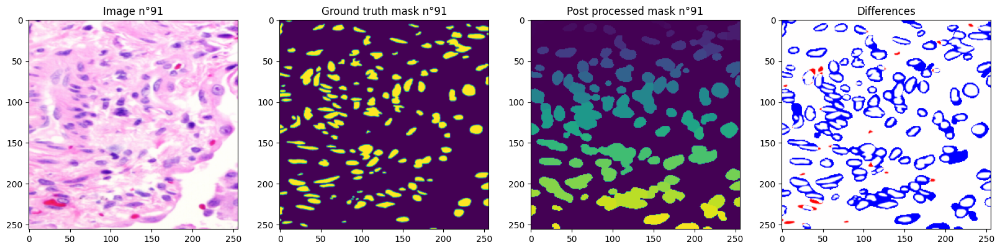

Number of true objects: 29
Number of predicted objects: 22
Thresh	TP	FP	FN	Prec.
0.500	21	1	8	0.700
0.550	19	3	10	0.594
0.600	18	4	11	0.545
0.650	18	4	11	0.545
0.700	18	4	11	0.545
0.750	18	4	11	0.545
0.800	18	4	11	0.545
0.850	18	4	11	0.545
0.900	17	5	12	0.500
0.950	9	13	20	0.214
AP	-	-	-	0.528


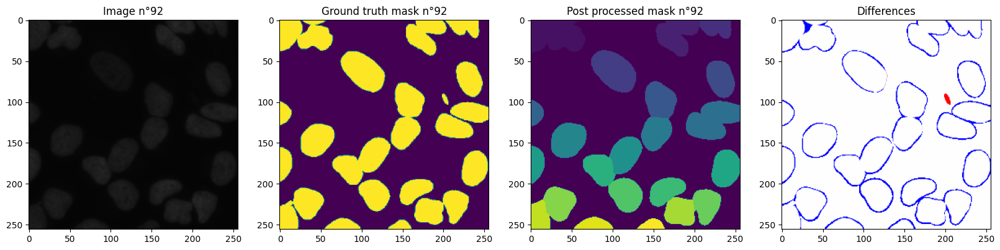

Number of true objects: 3
Number of predicted objects: 2
Thresh	TP	FP	FN	Prec.
0.500	2	0	1	0.667
0.550	2	0	1	0.667
0.600	2	0	1	0.667
0.650	2	0	1	0.667
0.700	1	1	2	0.250
0.750	1	1	2	0.250
0.800	1	1	2	0.250
0.850	1	1	2	0.250
0.900	1	1	2	0.250
0.950	0	2	3	0.000
AP	-	-	-	0.392


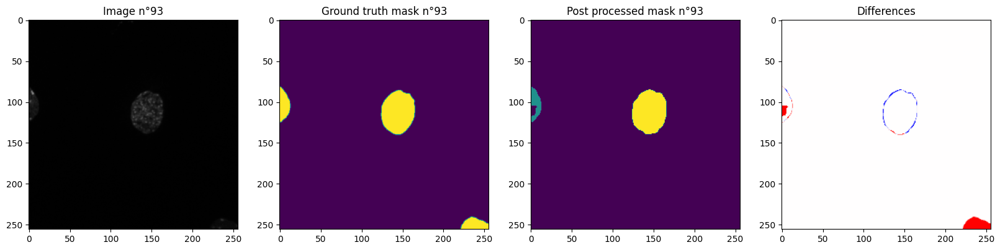

Number of true objects: 28
Number of predicted objects: 21
Thresh	TP	FP	FN	Prec.
0.500	21	0	7	0.750
0.550	21	0	7	0.750
0.600	21	0	7	0.750
0.650	21	0	7	0.750
0.700	21	0	7	0.750
0.750	21	0	7	0.750
0.800	21	0	7	0.750
0.850	20	1	8	0.690
0.900	18	3	10	0.581
0.950	9	12	19	0.225
AP	-	-	-	0.675


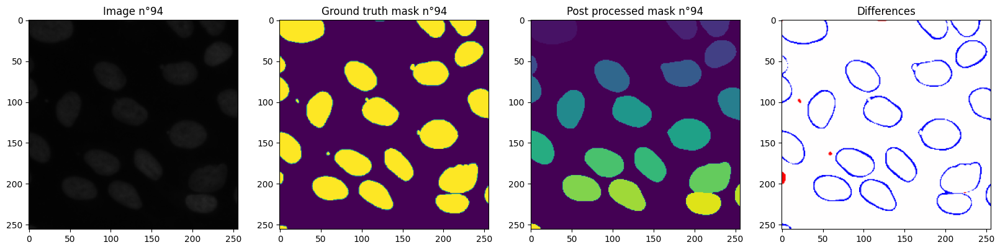

Number of true objects: 8
Number of predicted objects: 8
Thresh	TP	FP	FN	Prec.
0.500	8	0	0	1.000
0.550	8	0	0	1.000
0.600	8	0	0	1.000
0.650	8	0	0	1.000
0.700	8	0	0	1.000
0.750	8	0	0	1.000
0.800	8	0	0	1.000
0.850	8	0	0	1.000
0.900	7	1	1	0.778
0.950	3	5	5	0.231
AP	-	-	-	0.901


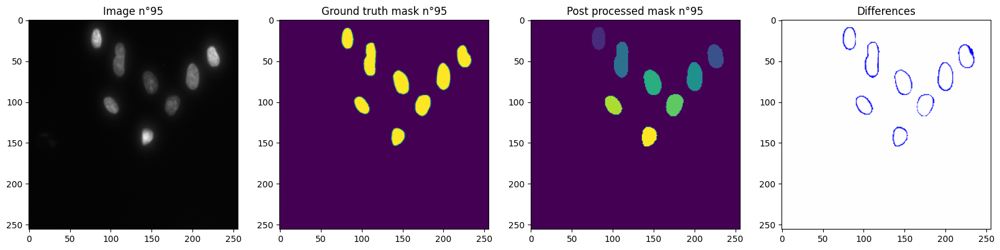

Number of true objects: 93
Number of predicted objects: 41
Thresh	TP	FP	FN	Prec.
0.500	30	11	63	0.288
0.550	28	13	65	0.264
0.600	28	13	65	0.264
0.650	24	17	69	0.218
0.700	21	20	72	0.186
0.750	18	23	75	0.155
0.800	12	29	81	0.098
0.850	3	38	90	0.023
0.900	1	40	92	0.008
0.950	0	41	93	0.000
AP	-	-	-	0.150


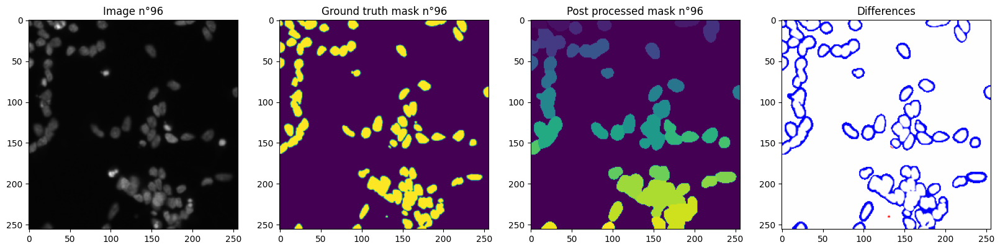

Number of true objects: 74
Number of predicted objects: 53
Thresh	TP	FP	FN	Prec.
0.500	45	8	29	0.549
0.550	45	8	29	0.549
0.600	45	8	29	0.549
0.650	44	9	30	0.530
0.700	40	13	34	0.460
0.750	40	13	34	0.460
0.800	40	13	34	0.460
0.850	39	14	35	0.443
0.900	24	29	50	0.233
0.950	3	50	71	0.024
AP	-	-	-	0.426


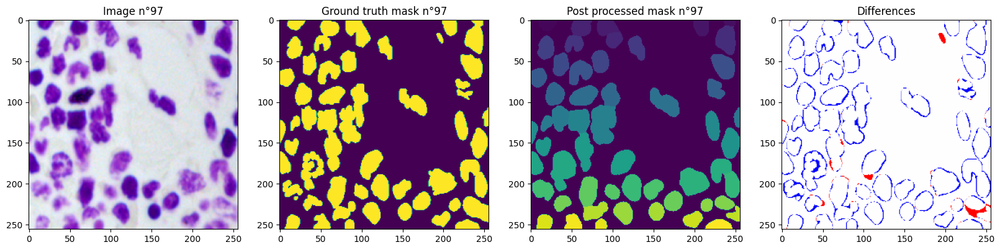

Number of true objects: 1
Number of predicted objects: 1
Thresh	TP	FP	FN	Prec.
0.500	1	0	0	1.000
0.550	1	0	0	1.000
0.600	1	0	0	1.000
0.650	1	0	0	1.000
0.700	1	0	0	1.000
0.750	1	0	0	1.000
0.800	1	0	0	1.000
0.850	1	0	0	1.000
0.900	1	0	0	1.000
0.950	0	1	1	0.000
AP	-	-	-	0.900


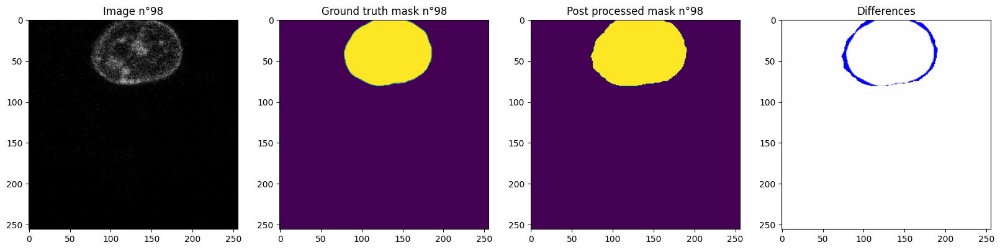

Number of true objects: 123
Number of predicted objects: 37
Thresh	TP	FP	FN	Prec.
0.500	18	19	105	0.127
0.550	15	22	108	0.103
0.600	13	24	110	0.088
0.650	11	26	112	0.074
0.700	10	27	113	0.067
0.750	6	31	117	0.039
0.800	2	35	121	0.013
0.850	1	36	122	0.006
0.900	0	37	123	0.000
0.950	0	37	123	0.000
AP	-	-	-	0.052


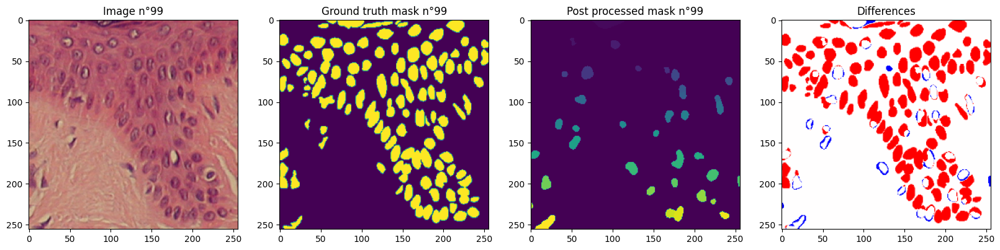

Number of true objects: 11
Number of predicted objects: 12
Thresh	TP	FP	FN	Prec.
0.500	11	1	0	0.917
0.550	11	1	0	0.917
0.600	11	1	0	0.917
0.650	11	1	0	0.917
0.700	11	1	0	0.917
0.750	10	2	1	0.769
0.800	10	2	1	0.769
0.850	9	3	2	0.643
0.900	8	4	3	0.533
0.950	0	12	11	0.000
AP	-	-	-	0.730


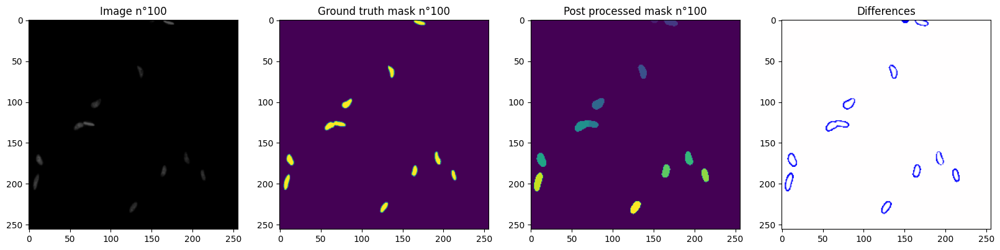

Number of true objects: 25
Number of predicted objects: 23
Thresh	TP	FP	FN	Prec.
0.500	21	2	4	0.778
0.550	21	2	4	0.778
0.600	21	2	4	0.778
0.650	21	2	4	0.778
0.700	21	2	4	0.778
0.750	21	2	4	0.778
0.800	21	2	4	0.778
0.850	21	2	4	0.778
0.900	17	6	8	0.548
0.950	9	14	16	0.231
AP	-	-	-	0.700


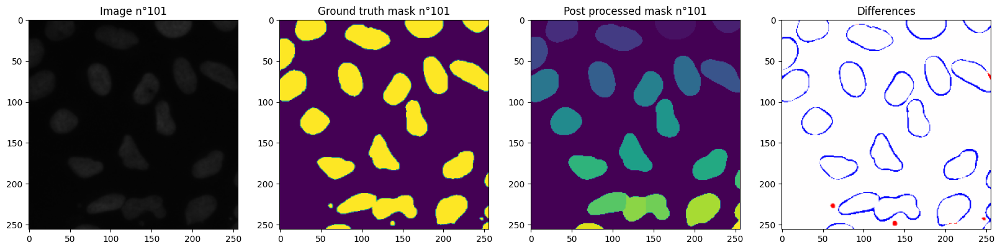

Number of true objects: 78
Number of predicted objects: 73
Thresh	TP	FP	FN	Prec.
0.500	56	17	22	0.589
0.550	55	18	23	0.573
0.600	52	21	26	0.525
0.650	47	26	31	0.452
0.700	33	40	45	0.280
0.750	19	54	59	0.144
0.800	9	64	69	0.063
0.850	2	71	76	0.013
0.900	1	72	77	0.007
0.950	0	73	78	0.000
AP	-	-	-	0.265


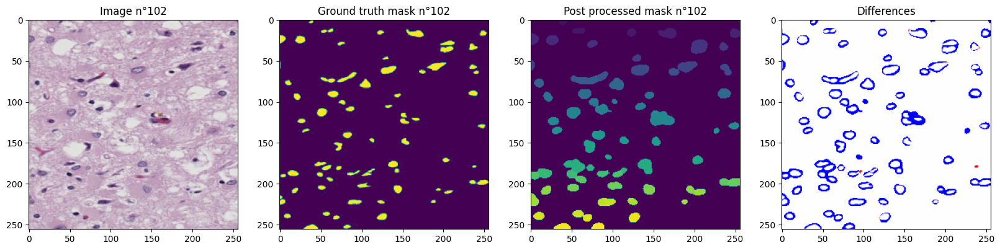

Number of true objects: 246
Number of predicted objects: 38
Thresh	TP	FP	FN	Prec.
0.500	16	22	230	0.060
0.550	15	23	231	0.056
0.600	15	23	231	0.056
0.650	14	24	232	0.052
0.700	12	26	234	0.044
0.750	10	28	236	0.036
0.800	10	28	236	0.036
0.850	10	28	236	0.036
0.900	9	29	237	0.033
0.950	1	37	245	0.004
AP	-	-	-	0.041


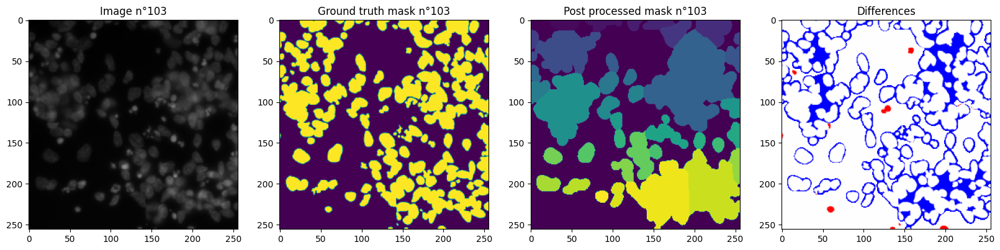

Number of true objects: 54
Number of predicted objects: 52
Thresh	TP	FP	FN	Prec.
0.500	42	10	12	0.656
0.550	39	13	15	0.582
0.600	39	13	15	0.582
0.650	39	13	15	0.582
0.700	37	15	17	0.536
0.750	31	21	23	0.413
0.800	27	25	27	0.342
0.850	21	31	33	0.247
0.900	13	39	41	0.140
0.950	0	52	54	0.000
AP	-	-	-	0.408


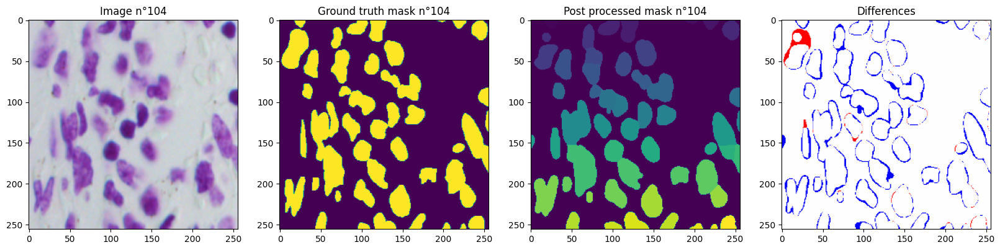

Number of true objects: 83
Number of predicted objects: 58
Thresh	TP	FP	FN	Prec.
0.500	46	12	37	0.484
0.550	45	13	38	0.469
0.600	43	15	40	0.439
0.650	40	18	43	0.396
0.700	39	19	44	0.382
0.750	36	22	47	0.343
0.800	32	26	51	0.294
0.850	27	31	56	0.237
0.900	13	45	70	0.102
0.950	1	57	82	0.007
AP	-	-	-	0.315


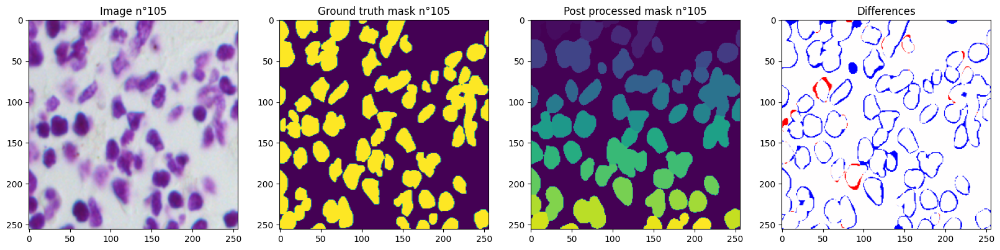

LB = 0.5188339657173581


In [70]:
# show_results(test_1_images, test_1_masks, test_1_labels, test_1_pred_masks, test_1_pp_masks, verbose=False)
show_results(pp_test_2_images, pp_test_2_masks, test_2_labels, test_2_pred_masks, test_2_pp_masks, verbose=True)

> # 18. Submission

In [77]:
!pip install --upgrade kaggle
import csv
from google.colab import files

# Run-length encoding taken from https://www.kaggle.com/rakhlin/fast-run-length-encoding-python
def rle_encoding(y):
    dots = np.where(y.T.flatten() == 1)[0]
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b + 1, 0))
        run_lengths[-1] += 1
        prev = b
    return run_lengths

def pred_to_rles(y):
    for i in range(1, y.max() + 1):
        yield rle_encoding(y == i)

def create_submission(preds, submission_path):
    uuids = [path.rsplit('/', 2)[0] for path in sorted(glob(TEST_2_PATH + '*/images/*.png'))]
    original_shapes = [read_image(image_path).shape[:2] for image_path in sorted(glob(TEST_2_PATH + '*/images/*.png'))]
    with open(submission_path, 'w', newline='') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(['ImageId', 'EncodedPixels'])

        for idx, (uid, y) in tqdm(enumerate(zip(uuids, preds))):
            uid = os.path.basename(uid)
            y = label(erosion(y, footprint=disk(2)))
            y_resized = resize(y, (original_shapes[idx][0], original_shapes[idx][1]), mode='constant', order=0, preserve_range=True, anti_aliasing=True)
            for rle in pred_to_rles(y_resized):
                writer.writerow([uid, ' '.join([str(i) for i in rle])])

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.7/79.7 kB 3.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for kaggle: filename=kaggle-1.6.12-py3-none-any.whl size=102969 sha256=b5b00c275003333d2f433f4062a54a1661d741caa755127279f46b4ae78b78ad
  Stored in directory: /root/.cache/pip/wheels/1e/0b/7c/50f8e89c3d2f82838dbd7afeddffbb9357003009ada98216c7
Successfully built kaggle
  Attempting uninstall: kaggle
    Found existing installation: kaggle 1.5.16
    Uninstalling kaggle-1.5.16:
      Successfully uninstalled kaggle-1.5.16


Saving kaggle.json to kaggle.json
User uploaded file "kaggle.json" with length 64 bytes


In [80]:
create_submission(test_2_pp_masks, SUBMISSION_PATH)
!kaggle competitions submit -c data-science-bowl-2018 -f "{SUBMISSION_PATH}" -m "Submission done with Colab"

0it [00:00, ?it/s]

100% 946k/946k [00:01<00:00, 770kB/s]
Successfully submitted to 2018 Data Science Bowl 